<a href="https://colab.research.google.com/github/Saoudyahya/Image-Debt-Estimation-Model-three-js-display/blob/main/working_code.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [4]:
!pip install cv2

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 67.0/67.0 MB 18.4 MB/s eta 0:00:00


CUDA is not available. Using CPU.
Loading MiDaS model for depth estimation...


Using cache found in /root/.cache/torch/hub/intel-isl_MiDaS_master
/usr/local/lib/python3.12/dist-packages/timm/models/layers/__init__.py:48: FutureWarning: Importing from timm.models.layers is deprecated, please import via timm.layers
  warnings.warn(f"Importing from {__name__} is deprecated, please import via timm.layers", FutureWarning)
/usr/local/lib/python3.12/dist-packages/timm/models/_factory.py:138: UserWarning: Mapping deprecated model name vit_base_resnet50_384 to current vit_base_r50_s16_384.orig_in21k_ft_in1k.
  model = create_fn(


Downloading: "https://github.com/isl-org/MiDaS/releases/download/v3/dpt_hybrid_384.pt" to /root/.cache/torch/hub/checkpoints/dpt_hybrid_384.pt


100%|██████████| 470M/470M [00:03<00:00, 154MB/s]


MiDaS DPT-Hybrid model loaded successfully
Please upload your drone video file:


Using cache found in /root/.cache/torch/hub/intel-isl_MiDaS_master


Saving Madeira _ Cinematic FPV.mp4 to Madeira _ Cinematic FPV.mp4
Processing drone video: Madeira _ Cinematic FPV.mp4
Processing video frames and estimating trajectory...
Video has 6724 frames at 29.97 fps
Processing up to 8 frames (every 10th frame)


IntProgress(value=0, bar_style='info', description='Processing:', max=8)

/tmp/ipython-input-2189281590.py:170: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colormap = cm.get_cmap(colormap_name)


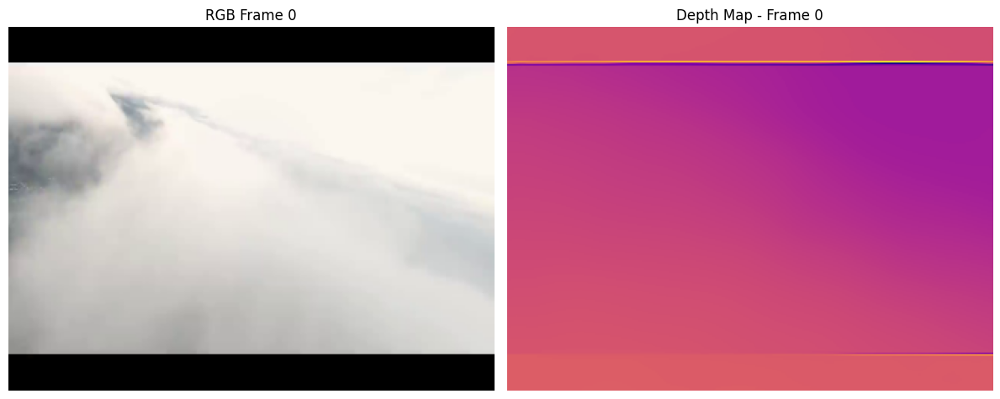

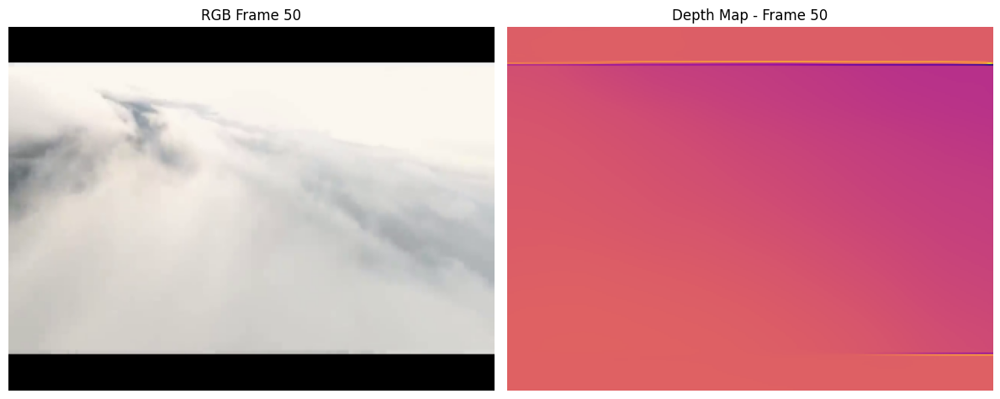

Processed 8 frames from the video
Estimating drone trajectory...
Estimating drone trajectory from video...


IntProgress(value=0, bar_style='info', description='Trajectory:', max=7)

Refining trajectory using depth information...
Smoothing trajectory...
Estimated trajectory with 8 points


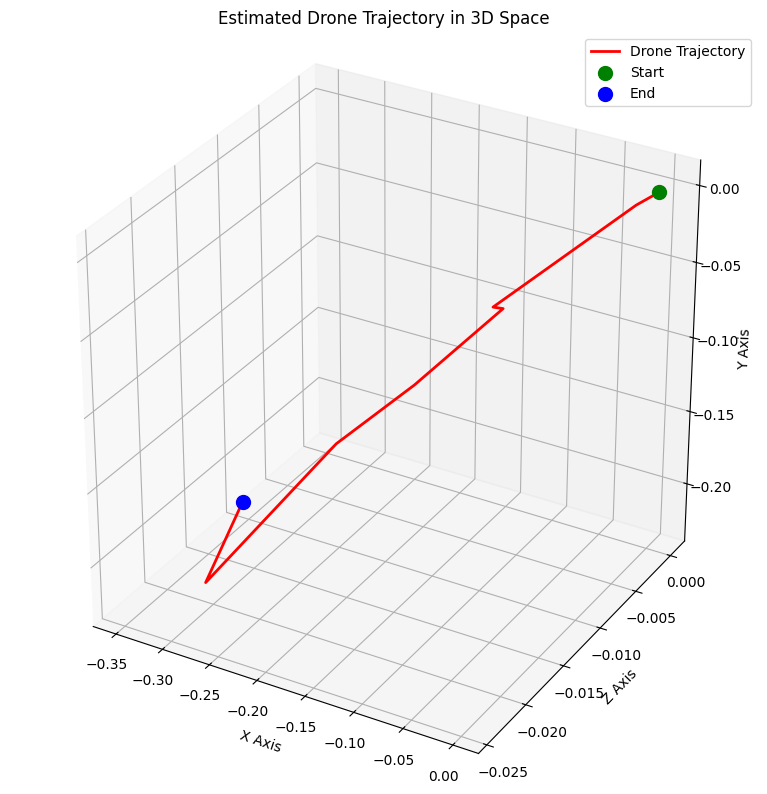

Extracted 8 frames with depth information
Estimated trajectory with 8 points
Creating 3D mesh representations...
Processing mesh data for frame 1/8...
Processing mesh data for frame 2/8...
Processing mesh data for frame 3/8...
Processing mesh data for frame 4/8...
Processing mesh data for frame 5/8...
Processing mesh data for frame 6/8...
Processing mesh data for frame 7/8...
Processing mesh data for frame 8/8...
Creating 3D Gaussian Splatting representations...
Processing Gaussian data for frame 1/8...
Processing Gaussian data for frame 2/8...
Processing Gaussian data for frame 3/8...
Processing Gaussian data for frame 4/8...
Processing Gaussian data for frame 5/8...
Processing Gaussian data for frame 6/8...
Processing Gaussian data for frame 7/8...
Processing Gaussian data for frame 8/8...
Creating visualization with trajectory estimation and frame blending...
Displaying drone footage 3D visualization with trajectory and frame blending...



Drone Footage Visualization With Trajectory Controls:

1. Trajectory Features:
   - Press 'T' or click 'Show Trajectory' to toggle trajectory visibility
   - Click 'Draw Trajectory' to manually draw a custom 3D trajectory
   - Click 'Use as Path' to use the trajectory as camera path
   - Adjust trajectory scale to modify its size in the visualization

2. Frame Blending Features:
   - Press 'B' or click 'Blending' to toggle frame blending
   - Adjust blend steps to control the number of intermediate frames
   - Adjust smoothness to control the blending quality
   - Creates smooth transitions between terrain blocks along the path

3. 3D Path Drawing:
   - Click 'Draw Path' to enter drawing mode
   - Click in the scene to place path points
   - Use mouse wheel to adjust height before clicking
   - Green sphere shows preview position
   - Click 'Finish' when done

4. Preset Paths:
   - Linear, Circle, or Spiral paths
   - Adjust path smoothing and block spacing

5. Navigation:
   - WASD: 

In [7]:
# 3D Depth Map Navigation with 3D Path Drawing and Trajectory Estimation for Drone Videos
# Enhanced with 3D drawing, trajectory estimation, frame blending, and improved UI
# NOW WITH CUSTOM TRAJECTORY DRAWING FEATURE

# Import necessary libraries
import os
import cv2
import torch
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import time
import base64
import io
import json
import IPython.display as display
from google.colab import files
from IPython.display import HTML, clear_output
from matplotlib import cm
import ipywidgets as widgets
from scipy.ndimage import gaussian_filter
from scipy.spatial.transform import Rotation

# Function to check if CUDA is available
def check_cuda():
    if torch.cuda.is_available():
        print(f"CUDA is available. Device: {torch.cuda.get_device_name(0)}")
        return torch.device("cuda")
    else:
        print("CUDA is not available. Using CPU.")
        return torch.device("cpu")

device = check_cuda()

# Function to load MiDaS model directly from torch hub
def load_midas_model():
    """
    Load the MiDaS model for depth estimation.

    Returns:
        model: The loaded model
        transform: Preprocessing transform for the model
    """
    print("Loading MiDaS model for depth estimation...")

    try:
        # Try loading the DPT-Hybrid model (good balance of speed and quality)
        model = torch.hub.load("intel-isl/MiDaS", "DPT_Hybrid")
        transform = torch.hub.load("intel-isl/MiDaS", "transforms").dpt_transform
        print("MiDaS DPT-Hybrid model loaded successfully")
    except Exception as e:
        print(f"Error loading hybrid model: {e}")
        try:
            # Fallback to the small model (faster but lower quality)
            model = torch.hub.load("intel-isl/MiDaS", "MiDaS_small")
            transform = torch.hub.load("intel-isl/MiDaS", "transforms").small_transform
            print("MiDaS small model loaded successfully (fallback)")
        except Exception as e:
            # Another fallback option using torch.hub loading
            print(f"Error loading models from hub: {e}")
            print("Attempting alternate loading method...")
            model = torch.hub.load("intel-isl/MiDaS:main", "MiDaS_small")
            transform = torch.hub.load("intel-isl/MiDaS:main", "transforms").small_transform
            print("MiDaS small model loaded via alternate method")

    model.to(device)
    model.eval()

    return model, transform

# Function to estimate depth using MiDaS model
def estimate_depth(img, model, transform):
    """
    Estimate depth from an image using the MiDaS model.

    Args:
        img (numpy.ndarray): Input image (RGB)
        model: The MiDaS model
        transform: Preprocessing transform for the model

    Returns:
        numpy.ndarray: Depth map
    """
    # Input sanity check
    if img.ndim != 3:
        raise ValueError("Input image must have 3 dimensions (H,W,C)")

    # Save original image dimensions
    h, w = img.shape[:2]

    # Apply transform to prepare the image
    input_batch = transform(img).to(device)

    # Perform inference
    with torch.no_grad():
        prediction = model(input_batch)

        # Some models output a dictionary
        if isinstance(prediction, dict):
            prediction = prediction['out']

        # Resize to original resolution
        prediction = torch.nn.functional.interpolate(
            prediction.unsqueeze(1),
            size=(h, w),
            mode="bicubic",
            align_corners=False,
        ).squeeze()

    # Convert to numpy and move to CPU
    depth = prediction.cpu().numpy()

    # Normalize depth map
    depth_min = depth.min()
    depth_max = depth.max()
    normalized_depth = (depth - depth_min) / (depth_max - depth_min)

    return normalized_depth

# Post-process depth map for better quality
def post_process_depth_map(depth_map, denoise=True, sharpen=True):
    """
    Apply post-processing to depth map for better quality.

    Args:
        depth_map (numpy.ndarray): Input depth map
        denoise (bool): Apply denoising
        sharpen (bool): Apply sharpening

    Returns:
        numpy.ndarray: Processed depth map
    """
    # Convert to float32 for processing
    depth = depth_map.astype(np.float32)

    # Apply bilateral filter to remove noise while preserving edges
    if denoise:
        depth = cv2.bilateralFilter(depth, 9, 0.1, 7)

    # Apply more bilateral filtering for smoothing
    if denoise:
        depth = cv2.bilateralFilter(depth, 5, 0.05, 5)  # Fine details
        depth = cv2.medianBlur(depth.astype(np.float32), 3)  # Remove speckle noise

    # Apply sharpening to enhance edges
    if sharpen:
        kernel = np.array([[-1, -1, -1], [-1, 9, -1], [-1, -1, -1]])
        depth = cv2.filter2D(depth, -1, kernel * 0.5)

    # Normalize again after processing
    depth_min = depth.min()
    depth_max = depth.max()
    depth = (depth - depth_min) / (depth_max - depth_min)

    return depth

# Apply colormap to depth map for visualization
def apply_colormap(depth_map, colormap_name='plasma'):
    """
    Apply a colormap to the depth map for visualization.

    Args:
        depth_map (numpy.ndarray): Depth map (normalized 0-1)
        colormap_name (str): Name of matplotlib colormap

    Returns:
        numpy.ndarray: Colored depth map (RGB)
    """
    # Get colormap from matplotlib
    colormap = cm.get_cmap(colormap_name)

    # Apply colormap
    colored_depth = (colormap(depth_map) * 255).astype(np.uint8)

    # Remove alpha channel if present
    if colored_depth.shape[-1] == 4:
        colored_depth = colored_depth[:, :, :3]

    return colored_depth

# Function to estimate camera motion between frames
def estimate_camera_motion(prev_frame, curr_frame):
    """
    Estimate camera motion between consecutive frames using feature tracking.

    Args:
        prev_frame (numpy.ndarray): Previous RGB frame
        curr_frame (numpy.ndarray): Current RGB frame

    Returns:
        tuple: (success, rotation_matrix, translation_vector)
    """
    # Convert frames to grayscale for feature detection
    prev_gray = cv2.cvtColor(prev_frame, cv2.COLOR_RGB2GRAY)
    curr_gray = cv2.cvtColor(curr_frame, cv2.COLOR_RGB2GRAY)

    # Detect features in previous frame
    prev_pts = cv2.goodFeaturesToTrack(prev_gray, maxCorners=100, qualityLevel=0.01, minDistance=10)

    if prev_pts is None or len(prev_pts) < 8:
        return False, None, None

    # Track features to current frame
    curr_pts, status, _ = cv2.calcOpticalFlowPyrLK(prev_gray, curr_gray, prev_pts, None)

    # Keep only good matches
    matches_mask = status.ravel() == 1
    if sum(matches_mask) < 8:  # Need at least 8 points for 8-point algorithm
        return False, None, None

    prev_pts = prev_pts[matches_mask]
    curr_pts = curr_pts[matches_mask]

    # Calculate essential matrix
    E, mask = cv2.findEssentialMat(
        curr_pts, prev_pts,
        focal=1.0, pp=(prev_gray.shape[1]/2, prev_gray.shape[0]/2),
        method=cv2.RANSAC, prob=0.999, threshold=1.0
    )

    if E is None:
        return False, None, None

    # Recover rotation and translation from essential matrix
    _, R_mat, t_vec, mask = cv2.recoverPose(
        E, curr_pts, prev_pts,
        focal=1.0, pp=(prev_gray.shape[1]/2, prev_gray.shape[0]/2)
    )

    return True, R_mat, t_vec

# Function to refine trajectory using depth information
def refine_trajectory_with_depth(trajectory, depth_maps):
    """
    Refine trajectory using depth information to correct scale and reduce drift.

    Args:
        trajectory (list): List of camera poses
        depth_maps (list): List of depth maps corresponding to frames

    Returns:
        list: Refined trajectory
    """
    if len(trajectory) < 2 or len(depth_maps) < len(trajectory):
        return trajectory

    refined_trajectory = [trajectory[0]]  # Keep first pose as is

    # Define a smoothing window for depth-based scale
    window_size = 3

    for i in range(1, len(trajectory)):
        pose = trajectory[i]
        prev_pose = refined_trajectory[i-1]

        # Extract position and direction
        curr_pos = pose["position"]
        prev_pos = prev_pose["position"]

        # Calculate raw translation
        raw_translation = curr_pos - prev_pos

        # Use depth information to refine scale
        # Calculate mean depth within a window
        start_idx = max(0, i - window_size)
        end_idx = min(len(depth_maps), i + window_size + 1)
        depth_window = depth_maps[start_idx:end_idx]
        mean_depth = np.mean([np.median(depth) for depth in depth_window])

        # Scale factor based on depth
        scale_factor = mean_depth * 0.1  # Adjust this multiplier as needed

        # Apply the scale factor to the translation
        scaled_translation = raw_translation * scale_factor

        # Limit the translation to reduce wild jumps (simple outlier rejection)
        max_translation = 2.0  # Maximum allowed translation between frames
        translation_norm = np.linalg.norm(scaled_translation)

        if translation_norm > max_translation:
            scaled_translation = scaled_translation * (max_translation / translation_norm)

        # Update the position
        refined_pos = prev_pos + scaled_translation

        # Create refined pose
        refined_pose = {
            "position": refined_pos,
            "rotation": pose["rotation"].copy()
        }

        refined_trajectory.append(refined_pose)

    return refined_trajectory

# Function to estimate drone trajectory from video frames
def estimate_drone_trajectory(frames, depth_maps, scale_factor=1.0):
    """
    Estimate the 3D trajectory of the drone from video frames and depth maps.

    Args:
        frames (list): List of RGB frames
        depth_maps (list): List of depth maps corresponding to frames
        scale_factor (float): Scale factor for translation (since scale is ambiguous in SfM)

    Returns:
        list: List of camera poses (position, rotation) along the trajectory
    """
    if len(frames) < 2:
        return []

    print("Estimating drone trajectory from video...")

    # Initialize trajectory with first frame at origin
    trajectory = [{"position": np.array([0., 0., 0.]), "rotation": np.eye(3)}]
    curr_position = np.array([0., 0., 0.])
    curr_rotation = np.eye(3)

    # Create progress bar for trajectory estimation
    progress = widgets.IntProgress(
        value=0,
        min=0,
        max=len(frames) - 1,
        description='Trajectory:',
        bar_style='info',
        orientation='horizontal'
    )
    display.display(progress)

    for i in range(1, len(frames)):
        # Estimate motion between consecutive frames
        success, R_mat, t_vec = estimate_camera_motion(frames[i-1], frames[i])

        if not success:
            # If motion estimation fails, use previous pose
            trajectory.append({
                "position": curr_position.copy(),
                "rotation": curr_rotation.copy()
            })
            progress.value = i
            continue

        # Scale translation using median depth to get more realistic scale
        median_depth = np.median(depth_maps[i])
        scaled_translation = scale_factor * median_depth * t_vec.reshape(3)

        # Update current pose
        curr_rotation = R_mat @ curr_rotation  # Apply rotation
        curr_position = curr_position + (curr_rotation @ scaled_translation)  # Apply translation

        # Store current pose
        trajectory.append({
            "position": curr_position.copy(),
            "rotation": curr_rotation.copy()
        })

        # Update progress
        progress.value = i

    # Refine trajectory using depth information
    print("Refining trajectory using depth information...")
    refined_trajectory = refine_trajectory_with_depth(trajectory, depth_maps)

    # Smooth trajectory to reduce noise
    print("Smoothing trajectory...")
    smoothed_trajectory = smooth_trajectory(refined_trajectory)

    # Process trajectory for visualization (convert to proper coordinate system)
    vis_trajectory = []
    for pose in smoothed_trajectory:
        # Convert to visualization coordinate system (adjust for Three.js)
        pos = pose["position"]
        # Apply coordinate system transformation for Three.js
        vis_trajectory.append({
            "x": float(pos[0]),
            "y": float(pos[1]),  # Y is up in Three.js
            "z": float(pos[2]),
        })

    return vis_trajectory

# Function to smooth trajectory
def smooth_trajectory(trajectory, window_size=5):
    """
    Apply smoothing to the trajectory to reduce noise.

    Args:
        trajectory (list): List of camera poses
        window_size (int): Size of the smoothing window

    Returns:
        list: Smoothed trajectory
    """
    if len(trajectory) <= window_size:
        return trajectory

    smoothed_trajectory = []

    # Keep first few poses as is
    for i in range(window_size // 2):
        smoothed_trajectory.append({
            "position": trajectory[i]["position"].copy(),
            "rotation": trajectory[i]["rotation"].copy()
        })

    # Apply smoothing to middle poses
    for i in range(window_size // 2, len(trajectory) - window_size // 2):
        # Average positions in the window
        avg_position = np.zeros(3)
        for j in range(-window_size // 2, window_size // 2 + 1):
            avg_position += trajectory[i + j]["position"]
        avg_position /= window_size

        # Create smoothed pose (keep original rotation)
        smoothed_trajectory.append({
            "position": avg_position,
            "rotation": trajectory[i]["rotation"].copy()
        })

    # Keep last few poses as is
    for i in range(len(trajectory) - window_size // 2, len(trajectory)):
        smoothed_trajectory.append({
            "position": trajectory[i]["position"].copy(),
            "rotation": trajectory[i]["rotation"].copy()
        })

    return smoothed_trajectory

# Function to visualize trajectory in 3D
def visualize_trajectory_3d(trajectory):
    """
    Visualize the estimated trajectory in 3D.

    Args:
        trajectory (list): List of trajectory points
    """
    if len(trajectory) < 2:
        print("Not enough trajectory points to visualize")
        return

    # Extract x, y, z coordinates
    x_coords = [p['x'] for p in trajectory]
    y_coords = [p['y'] for p in trajectory]
    z_coords = [p['z'] for p in trajectory]

    # Create 3D plot
    fig = plt.figure(figsize=(10, 8))
    ax = fig.add_subplot(111, projection='3d')

    # Plot trajectory line
    ax.plot3D(x_coords, z_coords, y_coords, 'r-', linewidth=2, label='Drone Trajectory')

    # Mark start and end points
    ax.scatter([x_coords[0]], [z_coords[0]], [y_coords[0]], color='green', s=100, label='Start')
    ax.scatter([x_coords[-1]], [z_coords[-1]], [y_coords[-1]], color='blue', s=100, label='End')

    # Add labels
    ax.set_xlabel('X Axis')
    ax.set_ylabel('Z Axis')
    ax.set_zlabel('Y Axis')
    ax.set_title('Estimated Drone Trajectory in 3D Space')

    # Add grid and legend
    ax.grid(True)
    ax.legend()

    # Show equal aspect ratio
    ax.set_box_aspect([1, 1, 1])

    plt.tight_layout()
    plt.show()

# Blend two frames based on weights
def blend_frames(frame1, frame2, weight):
    """
    Blend two frames based on weight.

    Args:
        frame1 (dict): First frame data
        frame2 (dict): Second frame data
        weight (float): Blending weight (0-1), 0 means all frame1, 1 means all frame2

    Returns:
        dict: Blended frame data
    """
    # Ensure weight is in [0,1]
    weight = max(0, min(1, weight))

    # Blend depth maps
    blended_depth = (1 - weight) * frame1['depth'] + weight * frame2['depth']

    # Blend RGB frames
    blended_rgb = np.uint8((1 - weight) * frame1['rgb_frame'] + weight * frame2['rgb_frame'])

    # Apply colormap to the blended depth map
    blended_colored_depth = apply_colormap(blended_depth)

    # Create blended frame data
    blended_frame = {
        'depth': blended_depth,
        'colored_depth': blended_colored_depth,
        'rgb_frame': blended_rgb,
        'frame_index': frame1['frame_index'] + weight * (frame2['frame_index'] - frame1['frame_index'])
    }

    return blended_frame

# Process video frames with trajectory estimation
def process_video_frames_with_trajectory(video_path, model, transform, max_frames=30, frame_step=10):
    """
    Process video frames with trajectory estimation.

    Args:
        video_path (str): Path to input video
        model: The depth estimation model
        transform: Preprocessing transform for the model
        max_frames (int): Maximum number of frames to process
        frame_step (int): Process every Nth frame

    Returns:
        tuple: (processed_frames, estimated_trajectory)
    """
    # Open the video
    cap = cv2.VideoCapture(video_path)
    if not cap.isOpened():
        raise ValueError(f"Could not open video file: {video_path}")

    # Get video info
    total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
    input_fps = cap.get(cv2.CAP_PROP_FPS)

    # Calculate number of frames to process
    process_frames = min(total_frames, max_frames * frame_step)

    print(f"Video has {total_frames} frames at {input_fps:.2f} fps")
    print(f"Processing up to {max_frames} frames (every {frame_step}th frame)")

    # Create progress bar
    progress = widgets.IntProgress(
        value=0, min=0, max=max_frames,
        description='Processing:',
        bar_style='info',
        orientation='horizontal'
    )
    display.display(progress)

    # Process frames
    processed_frames = []
    original_frames = []  # Store original frames for trajectory estimation
    depth_maps = []       # Store depth maps for trajectory estimation
    frame_count = 0
    processed_count = 0

    # Target size for frames
    target_size = (320, 240)  # Width, height

    try:
        while cap.isOpened() and processed_count < max_frames and frame_count < process_frames:
            ret, frame = cap.read()
            if not ret:
                break

            # Process every frame_step frames
            if frame_count % frame_step == 0:
                # Convert BGR to RGB
                frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)

                # Resize frame to target size
                frame_resized = cv2.resize(frame_rgb, target_size, interpolation=cv2.INTER_AREA)

                # Store original frame for trajectory estimation
                original_frames.append(frame_resized.copy())

                # Estimate depth
                depth_map = estimate_depth(frame_resized, model, transform)
                depth_map = post_process_depth_map(depth_map)

                # Store depth map for trajectory estimation
                depth_maps.append(depth_map.copy())

                # Apply colormap for visualization
                colored_depth = apply_colormap(depth_map)

                # Store depth map information
                processed_frames.append({
                    'depth': depth_map,
                    'colored_depth': colored_depth,
                    'frame_index': frame_count,
                    'rgb_frame': frame_resized
                })

                # Show preview
                if processed_count == 0 or processed_count % 5 == 0:
                    plt.figure(figsize=(12, 6))
                    plt.subplot(1, 2, 1)
                    plt.imshow(frame_resized)
                    plt.title(f"RGB Frame {frame_count}")
                    plt.axis('off')

                    plt.subplot(1, 2, 2)
                    plt.imshow(colored_depth)
                    plt.title(f"Depth Map - Frame {frame_count}")
                    plt.axis('off')

                    plt.tight_layout()
                    plt.show()

                # Update progress
                processed_count += 1
                progress.value = processed_count

            frame_count += 1

    finally:
        cap.release()

    print(f"Processed {processed_count} frames from the video")

    # Estimate trajectory
    print("Estimating drone trajectory...")
    estimated_trajectory = estimate_drone_trajectory(original_frames, depth_maps, scale_factor=1.0)
    print(f"Estimated trajectory with {len(estimated_trajectory)} points")

    # Visualize the estimated trajectory
    visualize_trajectory_3d(estimated_trajectory)

    return processed_frames, estimated_trajectory

# Create 3D mesh data from depth map
def create_3d_mesh_data_from_depth(frame_data, height_scale=50.0, sampling=1):
    """
    Create 3D mesh data from a depth map frame.

    Args:
        frame_data (dict): Frame data with depth information
        height_scale (float): Scale factor for height values
        sampling (int): Sampling factor to reduce mesh complexity

    Returns:
        dict: 3D mesh data ready for Three.js
    """
    # Get depth data
    depth = frame_data['depth']
    colored_depth = frame_data['colored_depth']
    rgb_frame = frame_data['rgb_frame']

    # Get dimensions
    h, w = depth.shape

    # Sample points using given sampling factor
    y_indices, x_indices = np.mgrid[0:h:sampling, 0:w:sampling]

    # Create position, color and UV arrays
    positions = []
    colors = []
    uvs = []

    # Create vertex data
    for y_i, x_i in zip(y_indices.flatten(), x_indices.flatten()):
        # Get depth value
        z = float(depth[y_i, x_i] * height_scale)

        # Convert to normalized coordinates (-0.5 to 0.5)
        x = float((x_i / w - 0.5))
        y = float(-(y_i / h - 0.5))

        # Add position
        positions.extend([x, z, y])

        # Get color from depth colormap
        r, g, b = colored_depth[y_i, x_i] / 255.0
        colors.extend([float(r), float(g), float(b)])

        # Add UV coordinates
        u = float(x_i / w)
        v = float(y_i / h)
        uvs.extend([u, v])

    # Create face indices
    indices = []
    grid_width = w // sampling
    grid_height = h // sampling

    for y in range(grid_height - 1):
        for x in range(grid_width - 1):
            # Get indices for the current quad
            a = y * grid_width + x
            b = y * grid_width + x + 1
            c = (y + 1) * grid_width + x
            d = (y + 1) * grid_width + x + 1

            # Create two triangles
            indices.extend([a, b, c])
            indices.extend([b, d, c])

    # Create mesh data
    mesh_data = {
        'positions': positions,
        'colors': colors,
        'indices': indices,
        'uvs': uvs,
        'grid_width': grid_width,
        'grid_height': grid_height,
        'frame_index': int(frame_data['frame_index'])
    }

    return mesh_data

# Create Gaussian splatting data from depth map
def create_gaussian_splat_data(frame_data, height_scale=50.0, sampling=2, sigma_scale=0.2):
    """
    Create 3D Gaussian Splatting data from a depth map frame.

    Args:
        frame_data (dict): Frame data with depth and color information
        height_scale (float): Scale factor for height values
        sampling (int): Sampling factor to reduce point count
        sigma_scale (float): Scale factor for Gaussian standard deviation

    Returns:
        dict: 3D Gaussian splat data ready for Three.js
    """
    # Get data
    depth = frame_data['depth']
    colored_depth = frame_data['colored_depth']
    rgb_frame = frame_data['rgb_frame']

    # Get dimensions
    h, w = depth.shape

    # Create point cloud by sampling
    sampling = max(1, sampling)
    y_indices, x_indices = np.mgrid[0:h:sampling, 0:w:sampling]

    # Create arrays for Gaussian data
    positions = []
    colors = []
    sizes = []

    # Create Gaussian data for each sampled point
    point_count = 0
    for y_i, x_i in zip(y_indices.flatten(), x_indices.flatten()):
        # Skip edge pixels
        if y_i >= h-1 or x_i >= w-1:
            continue

        # Get depth value
        depth_value = depth[y_i, x_i]
        z = float(depth_value * height_scale)

        # Convert to normalized coordinates
        x = float((x_i / w - 0.5))
        y = float(-(y_i / h - 0.5))

        # Add position
        positions.extend([x, z, y])

        # Get color from the depth colormap
        r, g, b = colored_depth[y_i, x_i] / 255.0

        # Full alpha for visibility
        alpha = 1.0

        colors.extend([float(r), float(g), float(b), float(alpha)])

        # Fixed size for all points
        size = sigma_scale * 30.0
        sizes.extend([float(size), float(size), float(size)])

        point_count += 1

    # Create Gaussian splat data
    gaussian_data = {
        'positions': positions,
        'colors': colors,
        'sizes': sizes,
        'num_points': point_count,
        'frame_index': int(frame_data['frame_index'])
    }

    return gaussian_data

# Custom JSON encoder
class NumpyEncoder(json.JSONEncoder):
    def default(self, obj):
        if isinstance(obj, np.integer):
            return int(obj)
        elif isinstance(obj, np.floating):
            return float(obj)
        elif isinstance(obj, np.ndarray):
            return obj.tolist()
        return super(NumpyEncoder, self).default(obj)

# Create visualization with 3D path drawing, frame blending and trajectory visualization for drone videos
def create_path_based_visualization(mesh_data_list, gaussian_data_list, trajectory_data=None):
    """
    Create a Three.js visualization where users can draw a 3D path, view the estimated
    trajectory, and terrain blocks follow the path with blending between frames.

    Args:
        mesh_data_list (list): List of mesh data for each frame
        gaussian_data_list (list): List of Gaussian splat data for each frame
        trajectory_data (list, optional): List of estimated trajectory points

    Returns:
        str: HTML content for visualization
    """
    # Convert data to JSON
    mesh_data_json = json.dumps(mesh_data_list, cls=NumpyEncoder)
    gaussian_data_json = json.dumps(gaussian_data_list, cls=NumpyEncoder)
    trajectory_json = json.dumps(trajectory_data or [], cls=NumpyEncoder)  # Handle None case

    # Create HTML content with 3D path drawing feature, trajectory visualization, and improved UI
    html_content = '''
    <!DOCTYPE html>
    <html lang="en">
    <head>
        <meta charset="UTF-8">
        <meta name="viewport" content="width=device-width, initial-scale=1.0">
        <title>Drone Footage 3D Visualization with Trajectory Estimation</title>
        <style>
            body {
                margin: 0;
                overflow: hidden;
                font-family: 'Segoe UI', Tahoma, Geneva, Verdana, sans-serif;
                color: #eee;
            }
            #container {
                width: 100%;
                height: 100vh;
            }
            #info {
                position: absolute;
                top: 10px;
                width: 100%;
                text-align: center;
                color: white;
                z-index: 100;
                text-shadow: 1px 1px 2px rgba(0,0,0,0.8);
                pointer-events: none;
                font-size: 16px;
                font-weight: 500;
            }
            .panel {
                position: absolute;
                background: rgba(0,0,0,0.65);
                padding: 6px;
                color: white;
                z-index: 100;
                border-radius: 6px;
                box-shadow: 0 4px 8px rgba(0,0,0,0.2);
                max-width: 220px;
                transition: all 0.3s ease;
                border: 1px solid rgba(255,255,255,0.1);
            }
            .panel h3 {
                margin: 0 0 5px 0;
                font-size: 14px;
                position: relative;
                display: flex;
                align-items: center;
                justify-content: space-between;
                cursor: pointer;
                padding-bottom: 4px;
                border-bottom: 1px solid rgba(255,255,255,0.1);
            }
            .panel h3::after {
                content: "−";
                font-size: 16px;
            }
            .panel.collapsed h3::after {
                content: "+";
            }
            .panel.collapsed .panel-content {
                display: none;
            }

            /* Panel positions */
            #pathControls {
                top: 50px;
                left: 10px;
            }
            #trajectoryControls {
                top: 280px;
                left: 10px;
            }
            #renderControls {
                top: 360px;
                left: 10px;
            }
            #blendingControls {
                top: 480px;
                left: 10px;
            }
            #animationControls {
                top: 50px;
                right: 10px;
            }
            #viewControls {
                top: 185px;
                right: 10px;
            }
            #navigationControls {
                bottom: 10px;
                left: 10px;
            }
            #heightControls {
                bottom: 10px;
                right: 10px;
            }

            /* Instruction panel */
            #instructionPanel {
                position: absolute;
                top: 50%;
                left: 50%;
                transform: translate(-50%, -50%);
                background: rgba(0,0,0,0.85);
                color: white;
                padding: 15px;
                border-radius: 8px;
                display: none;
                z-index: 201;
                max-width: 350px;
                text-align: center;
                border: 1px solid rgba(255,255,255,0.15);
                box-shadow: 0 5px 15px rgba(0,0,0,0.5);
            }
            #instructionPanel h3 {
                margin-top: 0;
                color: #4df;
            }

            /* Button groups */
            .button-group {
                display: flex;
                gap: 5px;
                margin-top: 6px;
                flex-wrap: wrap;
                justify-content: flex-start;
            }

            /* Button styling */
            button {
                padding: 4px 8px;
                cursor: pointer;
                border: none;
                border-radius: 4px;
                background: #333;
                color: white;
                font-weight: 500;
                font-size: 12px;
                min-width: 28px;
                transition: all 0.2s ease;
                box-shadow: 0 1px 3px rgba(0,0,0,0.2);
            }
            button:hover {
                background: #555;
                transform: translateY(-1px);
            }
            button.active {
                background: #0066cc;
                box-shadow: 0 0 5px rgba(0, 102, 204, 0.5);
            }
            button.danger {
                background: #cc0000;
            }
            button.danger:hover {
                background: #ff0000;
            }
            button.trajectory {
                background: #9900cc;
            }
            button.trajectory:hover {
                background: #bb00ff;
            }
            button.trajectory.active {
                background: #dd00ff;
                box-shadow: 0 0 5px rgba(221, 0, 255, 0.5);
            }

            /* Sliders */
            .slider-container {
                margin-top: 6px;
                display: flex;
                align-items: center;
                gap: 6px;
                font-size: 12px;
            }
            .slider-label {
                min-width: 80px;
                white-space: nowrap;
            }
            input[type="range"] {
                flex: 1;
                height: 4px;
                -webkit-appearance: none;
                appearance: none;
                background: #555;
                outline: none;
                border-radius: 2px;
            }
            input[type="range"]::-webkit-slider-thumb {
                -webkit-appearance: none;
                appearance: none;
                width: 12px;
                height: 12px;
                background: #0088ff;
                border-radius: 50%;
                cursor: pointer;
                transition: all 0.2s;
            }
            input[type="range"]::-webkit-slider-thumb:hover {
                background: #00aaff;
                transform: scale(1.2);
            }

            /* Play button */
            #playBtn {
                background: #4CAF50;
                font-size: 14px;
                padding: 5px 12px;
                margin-bottom: 5px;
            }
            #playBtn:hover {
                background: #45a049;
            }
            #playBtn.playing {
                background: #f44336;
            }
            #playBtn.playing:hover {
                background: #da190b;
            }

            /* Drawing mode */
            .draw-mode-active {
                background: #ff6600 !important;
            }

            /* Tooltips */
            [data-tooltip] {
                position: relative;
            }
            [data-tooltip]:hover::after {
                content: attr(data-tooltip);
                position: absolute;
                bottom: 100%;
                left: 50%;
                transform: translateX(-50%);
                background: rgba(0,0,0,0.8);
                padding: 4px 8px;
                border-radius: 4px;
                font-size: 12px;
                white-space: nowrap;
                z-index: 200;
                pointer-events: none;
                margin-bottom: 5px;
            }

            /* Mobile optimization */
            @media (max-width: 768px) {
                .panel {
                    padding: 4px;
                    max-width: 180px;
                    font-size: 11px;
                }
                button {
                    padding: 3px 6px;
                    font-size: 11px;
                }
                .slider-label {
                    min-width: 60px;
                }
                #info {
                    font-size: 14px;
                }
            }

            /* Progress bar */
            #progressBar {
                position: absolute;
                bottom: 0;
                left: 0;
                height: 3px;
                background: #0088ff;
                width: 0%;
                transition: width 0.1s linear;
            }

            /* Status indicators */
            #statusIndicators {
                position: absolute;
                top: 10px;
                left: 10px;
                display: flex;
                gap: 10px;
                z-index: 99;
            }
            .indicator {
                background: rgba(0,0,0,0.5);
                padding: 3px 8px;
                border-radius: 10px;
                font-size: 12px;
                display: flex;
                align-items: center;
            }
            .indicator::before {
                content: "";
                display: inline-block;
                width: 8px;
                height: 8px;
                border-radius: 50%;
                margin-right: 5px;
            }
            #fpsIndicator::before {
                background: #4CAF50;
            }
            #modeIndicator::before {
                background: #0088ff;
            }
            #frameIndicator::before {
                background: #ff6600;
            }
            .trajectory-label {
                color: #dd00ff;
                text-align: center;
                font-size: 12px;
                font-weight: bold;
                background: rgba(0,0,0,0.5);
                padding: 2px 5px;
                border-radius: 3px;
                margin-top: 5px;
            }
        </style>
    </head>
    <body>
        <div id="container"></div>
        <div id="progressBar"></div>
        <div id="statusIndicators">
            <div id="fpsIndicator" class="indicator">60 FPS</div>
            <div id="modeIndicator" class="indicator">Mesh Mode</div>
            <div id="frameIndicator" class="indicator">Frame: 0/0</div>
        </div>

        <div id="info">Drone Footage 3D Visualization with Trajectory Estimation</div>

        <div id="instructionPanel">
            <h3>Drawing 3D Path</h3>
            <p id="drawingModeText">Click in the scene to place path points.<br>
            Use mouse wheel to adjust height before clicking.</p>
            <p>Current position: <span id="currentCoords">X: 0, Y: 0, Z: 0</span></p>
            <div class="button-group">
                <button id="undoPointBtn" data-tooltip="Remove last point">Undo</button>
                <button id="clearDrawingBtn" class="danger" data-tooltip="Clear all points">Clear</button>
                <button id="finishPathBtn" data-tooltip="Complete the path">Finish</button>
                <button id="cancelPathBtn" class="danger" data-tooltip="Exit without saving">Cancel</button>
            </div>
        </div>

        <div id="pathControls" class="panel">
            <h3>Path Controls</h3>
            <div class="panel-content">
                <div class="button-group">
                    <button id="drawPathBtn" data-tooltip="Start drawing a custom path">Draw Path</button>
                    <button id="resetPathBtn" data-tooltip="Reset to default path">Reset</button>
                </div>
                <div class="slider-container">
                    <span class="slider-label">Spacing:</span>
                    <input type="range" id="pathSpacingSlider" min="1" max="20" value="5">
                    <span id="pathSpacingValue">5</span>
                </div>
                <div class="slider-container">
                    <span class="slider-label">Smoothing:</span>
                    <input type="range" id="pathSmoothingSlider" min="0" max="10" value="5">
                    <span id="pathSmoothingValue">5</span>
                </div>
                <div class="button-group">
                    <button id="linearPathBtn" data-tooltip="Create a straight line path">Linear</button>
                    <button id="circularPathBtn" data-tooltip="Create a circular path">Circle</button>
                    <button id="spiralPathBtn" data-tooltip="Create a spiral path">Spiral</button>
                </div>
            </div>
        </div>

        <div id="trajectoryControls" class="panel">
            <h3>Trajectory</h3>
            <div class="panel-content">
                <div class="button-group">
                    <button id="showTrajectoryBtn" class="trajectory" data-tooltip="Show drone's flight trajectory">Show Trajectory</button>
                    <button id="drawTrajectoryBtn" class="trajectory" data-tooltip="Draw a custom trajectory">Draw Trajectory</button>
                    <button id="useTrajectoryBtn" class="trajectory" data-tooltip="Use trajectory as camera path">Use as Path</button>
                </div>
                <div class="slider-container">
                    <span class="slider-label">Scale:</span>
                    <input type="range" id="trajectoryScaleSlider" min="0.1" max="5" value="1" step="0.1">
                    <span id="trajectoryScaleValue">1.0</span>
                </div>
                <div id="trajectorySourceLabel" class="trajectory-label">Estimated from video</div>
            </div>
        </div>

        <div id="renderControls" class="panel">
            <h3>Rendering</h3>
            <div class="panel-content">
                <div class="button-group">
                    <button id="meshBtn" class="active" data-tooltip="Render as 3D mesh">Mesh</button>
                    <button id="gaussianBtn" data-tooltip="Render as point cloud">Points</button>
                    <button id="hybridBtn" data-tooltip="Both mesh and points">Hybrid</button>
                    <button id="wireframeBtn" data-tooltip="Wireframe view">Wire</button>
                </div>
                <div class="slider-container">
                    <span class="slider-label">Block Scale:</span>
                    <input type="range" id="blockScaleSlider" min="1" max="20" value="10">
                    <span id="blockScaleValue">10</span>
                </div>
                <div class="slider-container">
                    <span class="slider-label">Height:</span>
                    <input type="range" id="heightScaleSlider" min="1" max="100" value="50">
                    <span id="heightScaleValue">50</span>
                </div>
            </div>
        </div>

        <div id="blendingControls" class="panel">
            <h3>Frame Blending</h3>
            <div class="panel-content">
                <div class="button-group">
                    <button id="blendingToggleBtn" class="active" data-tooltip="Toggle frame blending">Blending: ON</button>
                </div>
                <div class="slider-container">
                    <span class="slider-label">Blend Steps:</span>
                    <input type="range" id="blendStepsSlider" min="1" max="10" value="3">
                    <span id="blendStepsValue">3</span>
                </div>
                <div class="slider-container">
                    <span class="slider-label">Smoothness:</span>
                    <input type="range" id="blendSmoothSlider" min="0" max="10" value="5">
                    <span id="blendSmoothValue">5</span>
                </div>
            </div>
        </div>

        <div id="animationControls" class="panel">
            <h3>Animation</h3>
            <div class="panel-content">
                <button id="playBtn">▶ Play</button>
                <div class="slider-container">
                    <span class="slider-label">Speed:</span>
                    <input type="range" id="animationSpeedSlider" min="1" max="10" value="3">
                    <span id="animationSpeedValue">3</span>
                </div>
                <div class="slider-container">
                    <span class="slider-label">Camera Height:</span>
                    <input type="range" id="cameraHeightSlider" min="5" max="100" value="20">
                    <span id="cameraHeightValue">20</span>
                </div>
            </div>
        </div>

        <div id="viewControls" class="panel">
            <h3>Camera</h3>
            <div class="panel-content">
                <div class="button-group">
                    <button id="followPathBtn" data-tooltip="Follow the path">Follow</button>
                    <button id="overviewBtn" class="active" data-tooltip="Bird's eye view">Overview</button>
                    <button id="topDownBtn" data-tooltip="View from above">Top</button>
                    <button id="firstPersonBtn" data-tooltip="First person perspective">FPV</button>
                    <button id="autoPilotBtn" data-tooltip="Automatic camera motion">Auto</button>
                </div>
            </div>
        </div>

        <div id="navigationControls" class="panel">
            <h3>Navigation</h3>
            <div class="panel-content">
                <div style="font-size: 12px; margin-bottom: 4px;">
                    <div>WASD: Move, Mouse: Look</div>
                    <div>R/F: Up/Down, Space: Reset</div>
                    <div>M: Cycle render modes</div>
                    <div>T: Toggle trajectory</div>
                    <div>B: Toggle blending</div>
                </div>
            </div>
        </div>

        <div id="heightControls" class="panel">
            <h3>Drawing</h3>
            <div class="panel-content">
                <div class="slider-container">
                    <span class="slider-label">Height:</span>
                    <input type="range" id="drawHeightSlider" min="-50" max="50" value="10" step="0.5">
                    <span id="drawHeightValue">10</span>
                </div>
                <div class="slider-container">
                    <span class="slider-label">Angle (X°):</span>
                    <input type="range" id="drawAngleXSlider" min="-180" max="180" value="0" step="5">
                    <span id="drawAngleXValue">0</span>
                </div>
                <div class="slider-container">
                    <span class="slider-label">Angle (Y°):</span>
                    <input type="range" id="drawAngleYSlider" min="-180" max="180" value="0" step="5">
                    <span id="drawAngleYValue">0</span>
                </div>
                <div class="button-group">
                    <button id="freeformBtn" class="active" data-tooltip="Free drawing mode">Free</button>
                    <button id="straightBtn" data-tooltip="Draw straight lines">Line</button>
                    <button id="snapToGridBtn" data-tooltip="Snap to grid">Grid: OFF</button>
                </div>
                <div class="slider-container">
                    <span class="slider-label">Grid Size:</span>
                    <input type="range" id="gridSnapSlider" min="1" max="20" value="5">
                    <span id="gridSnapValue">5</span>
                </div>
            </div>
        </div>

        <script src="https://cdnjs.cloudflare.com/ajax/libs/three.js/r134/three.min.js"></script>
        <script>
            // Data from Python
            const allMeshData = ''' + mesh_data_json + ''';
            const allGaussianData = ''' + gaussian_data_json + ''';
            const trajectoryData = ''' + trajectory_json + ''';

            // Global variables
            let scene, camera, renderer;
            let terrainBlocks = [];
            let currentPath = [];
            let pathLine = null;
            let pathPositions = [];
            let isDrawing = false;
            let isPlaying = false;
            let animationProgress = 0;
            let raycaster = new THREE.Raycaster();
            let mouse = new THREE.Vector2();
            let drawingHeight = 10;
            let drawingAngleX = 0;
            let drawingAngleY = 0;
            let previewSphere = null;
            let previewDirection = null;
            let drawingPath = [];
            let drawingAngles = [];  // Store angles for each point
            let drawingLine = null;
            let pathMarkers = [];
            let drawingMarkers = [];
            let isAutoPilot = false;
            let helperGrid = null;
            let heightIndicator = null;
            let coordinateLabel = null;
            let snapToGrid = false;
            let gridSnapSize = 5;
            let drawingMode = 'freeform';
            let stats = {fps: 0, frameCount: 0, lastTime: 0};
            let trajectoryLine = null;
            let trajectoryPoints = [];
            let showTrajectory = false;
            let trajectoryScale = 1.0;

            // Variables for custom trajectory drawing
            let customTrajectory = [];
            let isDrawingTrajectory = false;
            let customTrajectoryActive = false;

            // Frame blending settings
            let enableBlending = true;
            let blendSteps = 3;
            let blendSmoothness = 5;
            let blendedFrames = [];

            // Controls
            let controls = {
                moveForward: false,
                moveBackward: false,
                moveLeft: false,
                moveRight: false,
                moveUp: false,
                moveDown: false,
                speed: 10
            };
            let velocity = new THREE.Vector3();
            let direction = new THREE.Vector3();
            let prevTime = performance.now();
            let isPointerLocked = false;

            // Settings
            let renderMode = 'mesh';
            let blockScale = 10;
            let heightScale = 50;
            let pathSpacing = 5;
            let pathSmoothing = 5;
            let animationSpeed = 3;
            let cameraHeight = 20;
            let cameraMode = 'overview';

            // Initialize
            init();
            animate();

            function init() {
                // Create scene with dark theme
                scene = new THREE.Scene();
                scene.background = new THREE.Color(0x000033);
                scene.fog = new THREE.FogExp2(0x000033, 0.004);

                // Create camera
                camera = new THREE.PerspectiveCamera(75, window.innerWidth / window.innerHeight, 0.1, 1000);
                camera.position.set(0, 30, 50);
                camera.lookAt(0, 0, 0);

                // Create renderer
                renderer = new THREE.WebGLRenderer({ antialias: true });
                renderer.setSize(window.innerWidth, window.innerHeight);
                renderer.setPixelRatio(window.devicePixelRatio);
                renderer.shadowMap.enabled = true;
                renderer.shadowMap.type = THREE.PCFSoftShadowMap;
                document.getElementById('container').appendChild(renderer.domElement);

                // Add lighting
                const ambientLight = new THREE.AmbientLight(0xffffff, 0.6);
                scene.add(ambientLight);

                const directionalLight = new THREE.DirectionalLight(0xffffff, 0.8);
                directionalLight.position.set(1, 1, 1);
                directionalLight.castShadow = true;
                scene.add(directionalLight);

                // Add ground plane with better texture
                const groundGeometry = new THREE.PlaneGeometry(500, 500, 50, 50);
                const groundMaterial = new THREE.MeshPhongMaterial({
                    color: 0x111122,
                    side: THREE.DoubleSide,
                    wireframe: false,
                    shininess: 10
                });
                const ground = new THREE.Mesh(groundGeometry, groundMaterial);
                ground.rotation.x = Math.PI / 2;
                ground.position.y = -5;
                ground.receiveShadow = true;
                scene.add(ground);

                // Add grid helper with more subtle design
                const gridHelper = new THREE.GridHelper(100, 100, 0x444444, 0x222222);
                gridHelper.position.y = -4.9;
                scene.add(gridHelper);

                // Create preview sphere for 3D drawing with better visibility
                const sphereGeometry = new THREE.SphereGeometry(0.8, 16, 16);
                const sphereMaterial = new THREE.MeshBasicMaterial({
                    color: 0x00ff88,
                    transparent: true,
                    opacity: 0.7
                });
                previewSphere = new THREE.Mesh(sphereGeometry, sphereMaterial);
                previewSphere.visible = false;
                scene.add(previewSphere);

                // Create direction indicator for angle preview
                const arrowHelper = new THREE.ArrowHelper(
                    new THREE.Vector3(0, 0, 1), // direction
                    new THREE.Vector3(0, 0, 0), // origin
                    3,                          // length
                    0x00ffff,                   // color
                    0.5,                        // head length
                    0.3                         // head width
                );
                previewDirection = arrowHelper;
                previewDirection.visible = false;
                scene.add(previewDirection);

                // Add pulsating animation to preview sphere
                setInterval(() => {
                    if (previewSphere.visible) {
                        previewSphere.scale.x = 1 + Math.sin(Date.now() * 0.005) * 0.2;
                        previewSphere.scale.y = 1 + Math.sin(Date.now() * 0.005) * 0.2;
                        previewSphere.scale.z = 1 + Math.sin(Date.now() * 0.005) * 0.2;
                    }
                }, 50);

                // Create helper grid for drawing with better visibility
                helperGrid = new THREE.GridHelper(200, 40, 0x00ff88, 0x004422);
                helperGrid.visible = false;
                scene.add(helperGrid);

                // Create height indicator line with better visibility
                const lineGeometry = new THREE.BufferGeometry();
                const lineMaterial = new THREE.LineBasicMaterial({
                    color: 0x00ff88,
                    linewidth: 2
                });
                heightIndicator = new THREE.Line(lineGeometry, lineMaterial);
                heightIndicator.visible = false;
                scene.add(heightIndicator);

                // Create coordinate label sprite with better design
                const canvas = document.createElement('canvas');
                canvas.width = 256;
                canvas.height = 64;
                const context = canvas.getContext('2d');
                const texture = new THREE.CanvasTexture(canvas);
                const spriteMaterial = new THREE.SpriteMaterial({
                    map: texture,
                    transparent: true
                });
                coordinateLabel = new THREE.Sprite(spriteMaterial);
                coordinateLabel.scale.set(8, 2, 1);
                coordinateLabel.visible = false;
                scene.add(coordinateLabel);

                // Create a default linear path to start
                createLinearPath();

                // Update frame indicator
                updateFrameIndicator();

                // Setup controls
                setupControls();

                // Add panel minimization
                setupPanelMinimization();

                // Handle window resize
                window.addEventListener('resize', onWindowResize);

                // Set initial render mode
                setRenderMode('mesh');

                // Set up trajectory controls if trajectory data exists
                if (trajectoryData && trajectoryData.length > 0) {
                    document.getElementById('showTrajectoryBtn').addEventListener('click', toggleTrajectory);
                    document.getElementById('useTrajectoryBtn').addEventListener('click', useTrajectoryAsPath);

                    // Add event listener for drawing trajectory
                    document.getElementById('drawTrajectoryBtn').addEventListener('click', startDrawingTrajectory);

                    const trajectoryScaleSlider = document.getElementById('trajectoryScaleSlider');
                    trajectoryScaleSlider.addEventListener('input', (e) => {
                        trajectoryScale = parseFloat(e.target.value);
                        document.getElementById('trajectoryScaleValue').textContent = trajectoryScale.toFixed(1);

                        // Update trajectory visualization if it's visible
                        if (showTrajectory) {
                            clearTrajectory();
                            drawTrajectory();
                        }
                    });
                } else {
                    // Enable just custom trajectory drawing if no trajectory data
                    document.getElementById('trajectorySourceLabel').textContent = "Custom drawing only";
                    document.getElementById('showTrajectoryBtn').style.display = 'none';

                    // Add event listener for drawing trajectory
                    document.getElementById('drawTrajectoryBtn').addEventListener('click', startDrawingTrajectory);
                }

                // Setup blending controls
                setupBlendingControls();
            }

            // Setup blending controls
            function setupBlendingControls() {
                // Toggle blending button
                document.getElementById('blendingToggleBtn').addEventListener('click', () => {
                    enableBlending = !enableBlending;
                    document.getElementById('blendingToggleBtn').textContent = `Blending: ${enableBlending ? 'ON' : 'OFF'}`;
                    document.getElementById('blendingToggleBtn').classList.toggle('active', enableBlending);

                    // Regenerate terrain with or without blending
                    generateTerrainAlongPath();
                });

                // Blend steps slider
                document.getElementById('blendStepsSlider').addEventListener('input', (e) => {
                    blendSteps = parseInt(e.target.value);
                    document.getElementById('blendStepsValue').textContent = blendSteps;

                    if (enableBlending) {
                        generateTerrainAlongPath();
                    }
                });

                // Blend smoothness slider
                document.getElementById('blendSmoothSlider').addEventListener('input', (e) => {
                    blendSmoothness = parseInt(e.target.value);
                    document.getElementById('blendSmoothValue').textContent = blendSmoothness;

                    if (enableBlending) {
                        generateTerrainAlongPath();
                    }
                });
            }

            // Blend two meshes based on weight
            function blendMeshes(mesh1, mesh2, weight) {
                // Ensure weight is in [0,1]
                weight = Math.max(0, Math.min(1, weight));

                // Get positions from both meshes
                const positions1 = mesh1.geometry.attributes.position.array;
                const positions2 = mesh2.geometry.attributes.position.array;

                // Get colors from both meshes
                const colors1 = mesh1.geometry.attributes.color.array;
                const colors2 = mesh2.geometry.attributes.color.array;

                // Create new arrays for blended values
                const blendedPositions = new Float32Array(positions1.length);
                const blendedColors = new Float32Array(colors1.length);

                // Blend positions and colors
                for (let i = 0; i < positions1.length; i++) {
                    blendedPositions[i] = (1 - weight) * positions1[i] + weight * positions2[i];
                }

                for (let i = 0; i < colors1.length; i++) {
                    blendedColors[i] = (1 - weight) * colors1[i] + weight * colors2[i];
                }

                // Create blended geometry
                const blendedGeometry = new THREE.BufferGeometry();
                blendedGeometry.setAttribute('position', new THREE.BufferAttribute(blendedPositions, 3));
                blendedGeometry.setAttribute('color', new THREE.BufferAttribute(blendedColors, 3));

                // Copy indices from first mesh
                blendedGeometry.setIndex(mesh1.geometry.index);

                // Compute normals
                blendedGeometry.computeVertexNormals();

                // Create material
                const material = new THREE.MeshPhongMaterial({
                    vertexColors: true,
                    flatShading: false,
                    shininess: 30,
                    side: THREE.DoubleSide
                });

                // Create blended mesh
                return new THREE.Mesh(blendedGeometry, material);
            }

            // Start drawing a custom trajectory
            function startDrawingTrajectory() {
                isDrawing = true;
                isDrawingTrajectory = true;
                drawingPath = [];
                drawingAngles = [];

                // Clear any existing drawing markers
                drawingMarkers.forEach(marker => {
                    scene.remove(marker);
                });
                drawingMarkers = [];

                // Update the instruction panel title and text for trajectory
                document.getElementById('instructionPanel').querySelector('h3').textContent = "Drawing 3D Trajectory";
                document.getElementById('drawingModeText').innerHTML = "Click in the scene to place trajectory points.<br>Use mouse wheel to adjust height, and angle sliders to set direction.";
                document.getElementById('instructionPanel').style.display = 'block';
                document.getElementById('heightControls').style.display = 'block';
                document.getElementById('drawTrajectoryBtn').classList.add('draw-mode-active');

                // Change the preview sphere color to trajectory color
                previewSphere.material.color.set(0xff00ff); // Magenta for trajectory

                // Show drawing helpers
                previewSphere.visible = true;
                previewDirection.visible = true;
                helperGrid.visible = true;
                helperGrid.position.y = drawingHeight;
                heightIndicator.visible = true;
                coordinateLabel.visible = true;

                // Clear any existing drawing line
                if (drawingLine) {
                    scene.remove(drawingLine);
                    drawingLine = null;
                }

                // Add mouse event listeners
                renderer.domElement.addEventListener('mousemove', onMouseMove);
                renderer.domElement.addEventListener('click', onMouseClick);
                renderer.domElement.addEventListener('wheel', onMouseWheel);

                // Set initial drawing mode
                drawingMode = 'freeform';
                document.getElementById('freeformBtn').classList.add('active');
                document.getElementById('straightBtn').classList.remove('active');
            }

            // Finish drawing trajectory and save it
            function finishDrawingTrajectory() {
                isDrawing = false;
                isDrawingTrajectory = false;
                document.getElementById('instructionPanel').style.display = 'none';
                document.getElementById('heightControls').style.display = 'none';
                document.getElementById('drawTrajectoryBtn').classList.remove('draw-mode-active');

                // Hide drawing helpers
                previewSphere.visible = false;
                previewDirection.visible = false;
                helperGrid.visible = false;
                heightIndicator.visible = false;
                coordinateLabel.visible = false;

                // Remove event listeners
                renderer.domElement.removeEventListener('mousemove', onMouseMove);
                renderer.domElement.removeEventListener('click', onMouseClick);
                renderer.domElement.removeEventListener('wheel', onMouseWheel);

                // Use the drawn path as the custom trajectory
                if (drawingPath.length > 1) {
                    // Add angle information to points before smoothing
                    const pathWithAngles = drawingPath.map((point, index) => {
                        return {
                            ...point,
                            angleX: drawingAngles[index]?.angleX || 0,
                            angleY: drawingAngles[index]?.angleY || 0
                        };
                    });

                    // Smooth the path
                    const smoothedPath = smoothPath(pathWithAngles, pathSmoothing);
                    customTrajectory = smoothedPath;
                    customTrajectoryActive = true;

                    // Update trajectory label
                    document.getElementById('trajectorySourceLabel').textContent = "Custom drawn trajectory";

                    // Clear any existing trajectory and draw the new one
                    clearTrajectory();
                    showTrajectory = true;
                    drawCustomTrajectory();
                    document.getElementById('showTrajectoryBtn').classList.add('active');
                }

                // Clear drawing line
                if (drawingLine) {
                    scene.remove(drawingLine);
                    drawingLine = null;
                }

                // Clear drawing markers
                drawingMarkers.forEach(marker => {
                    scene.remove(marker);
                });
                drawingMarkers = [];
            }

            // Draw custom trajectory line
            function drawCustomTrajectory() {
                // Clear any existing trajectory
                clearTrajectory();

                if (!customTrajectory || customTrajectory.length < 2) return;

                // Create trajectory visualization
                const trajectoryGeometry = new THREE.BufferGeometry();
                const points = [];

                for (let point of customTrajectory) {
                    points.push(new THREE.Vector3(
                        point.x * trajectoryScale,
                        point.y * trajectoryScale,
                        point.z * trajectoryScale
                    ));
                }

                trajectoryGeometry.setFromPoints(points);

                const trajectoryMaterial = new THREE.LineBasicMaterial({
                    color: 0xff00ff,  // Magenta color to distinguish from path
                    linewidth: 3
                });

                trajectoryLine = new THREE.Line(trajectoryGeometry, trajectoryMaterial);
                scene.add(trajectoryLine);

                // Add trajectory points visualization
                const pointGeometry = new THREE.SphereGeometry(0.05, 8, 8);
                const pointMaterial = new THREE.MeshBasicMaterial({
                    color: 0xff00ff,
                    emissive: 0xff00ff,
                    emissiveIntensity: 0.5
                });

                // Add a point every few positions to avoid cluttering
                const pointInterval = Math.max(1, Math.floor(customTrajectory.length / 20));
                for (let i = 0; i < customTrajectory.length; i += pointInterval) {
                    const point = customTrajectory[i];
                    const marker = new THREE.Mesh(pointGeometry, pointMaterial);
                    marker.position.set(
                        point.x * trajectoryScale,
                        point.y * trajectoryScale,
                        point.z * trajectoryScale
                    );
                    scene.add(marker);
                    trajectoryPoints.push(marker);
                }

                // Add labels at start and end
                const startPointGeometry = new THREE.SphereGeometry(0.15, 5, 5);
                const startPointMaterial = new THREE.MeshBasicMaterial({ color: 0x00ff00 });
                const startMarker = new THREE.Mesh(startPointGeometry, startPointMaterial);

                const endPointGeometry = new THREE.SphereGeometry(0.15, 5, 5);
                const endPointMaterial = new THREE.MeshBasicMaterial({ color: 0x0000ff });
                const endMarker = new THREE.Mesh(endPointGeometry, endPointMaterial);

                // Position markers at start and end of trajectory
                const startPoint = customTrajectory[0];
                const endPoint = customTrajectory[customTrajectory.length - 1];

                startMarker.position.set(
                    startPoint.x * trajectoryScale,
                    startPoint.y * trajectoryScale,
                    startPoint.z * trajectoryScale
                );

                endMarker.position.set(
                    endPoint.x * trajectoryScale,
                    endPoint.y * trajectoryScale,
                    endPoint.z * trajectoryScale
                );

                scene.add(startMarker);
                scene.add(endMarker);

                trajectoryPoints.push(startMarker);
                trajectoryPoints.push(endMarker);

                // Create "START" and "END" text labels
                addTrajectoryLabel("START", startPoint, 0x00ff00);
                addTrajectoryLabel("END", endPoint, 0x0000ff);
            }

            // Add text label for trajectory points
            function addTrajectoryLabel(text, point, color) {
                const canvas = document.createElement('canvas');
                canvas.width = 128;
                canvas.height = 32;
                const context = canvas.getContext('2d');

                context.fillStyle = 'rgba(0,0,0,0.7)';
                context.fillRect(0, 0, canvas.width, canvas.height);

                // Add border
                context.strokeStyle = `rgba(${color === 0x00ff00 ? '0,255,0' : '0,0,255'},0.7)`;
                context.lineWidth = 2;
                context.strokeRect(2, 2, canvas.width-4, canvas.height-4);

                context.font = 'Bold 16px Arial';
                context.fillStyle = 'white';
                context.textAlign = 'center';
                context.textBaseline = 'middle';
                context.fillText(text, canvas.width/2, canvas.height/2);

                const texture = new THREE.CanvasTexture(canvas);
                const spriteMaterial = new THREE.SpriteMaterial({
                    map: texture,
                    transparent: true
                });

                const sprite = new THREE.Sprite(spriteMaterial);
                sprite.position.set(
                    point.x * trajectoryScale,
                    point.y * trajectoryScale + 2,
                    point.z * trajectoryScale
                );
                sprite.scale.set(4, 1, 1);

                scene.add(sprite);
                trajectoryPoints.push(sprite);
            }

            // Use custom trajectory as a path
            function useCustomTrajectoryAsPath() {
                if (!customTrajectory || customTrajectory.length < 2) return;

                // Convert custom trajectory to path format
                currentPath = [];

                for (let point of customTrajectory) {
                    currentPath.push({
                        x: point.x * trajectoryScale,
                        y: point.y * trajectoryScale,
                        z: point.z * trajectoryScale
                    });
                }

                // Update path visualization and terrain
                updatePathVisualization();
                generateTerrainAlongPath();

                document.getElementById('useTrajectoryBtn').classList.add('active');

                // Apply follow path camera mode
                setCameraMode('followPath');
            }

            // Clear trajectory visualization
            function clearTrajectory() {
                if (trajectoryLine) {
                    scene.remove(trajectoryLine);
                    trajectoryLine = null;
                }

                trajectoryPoints.forEach(point => {
                    scene.remove(point);
                });
                trajectoryPoints = [];
            }

            // Draw trajectory line
            function drawTrajectory() {
                // If custom trajectory is active, use that instead
                if (customTrajectoryActive) {
                    drawCustomTrajectory();
                    return;
                }

                // Clear any existing trajectory
                clearTrajectory();

                if (!trajectoryData || trajectoryData.length < 2) return;

                // Create trajectory visualization
                const trajectoryGeometry = new THREE.BufferGeometry();
                const points = [];

                for (let point of trajectoryData) {
                    // Apply scale to trajectory
                    points.push(new THREE.Vector3(
                        point.x * trajectoryScale,
                        point.y * trajectoryScale,
                        point.z * trajectoryScale
                    ));
                }

                trajectoryGeometry.setFromPoints(points);

                const trajectoryMaterial = new THREE.LineBasicMaterial({
                    color: 0xff00ff,  // Magenta color to distinguish from path
                    linewidth: 3
                });

                trajectoryLine = new THREE.Line(trajectoryGeometry, trajectoryMaterial);
                scene.add(trajectoryLine);

                // Add trajectory points visualization - SMALLER POINTS
                const pointGeometry = new THREE.SphereGeometry(0.05, 8, 8); // Reduced from 0.15 to 0.05
                const pointMaterial = new THREE.MeshBasicMaterial({
                    color: 0xff00ff,
                    emissive: 0xff00ff,
                    emissiveIntensity: 0.5
                });

                // Add a point every few positions to avoid cluttering
                const pointInterval = Math.max(1, Math.floor(trajectoryData.length / 20));
                for (let i = 0; i < trajectoryData.length; i += pointInterval) {
                    const point = trajectoryData[i];
                    const marker = new THREE.Mesh(pointGeometry, pointMaterial);
                    marker.position.set(
                        point.x * trajectoryScale,
                        point.y * trajectoryScale,
                        point.z * trajectoryScale
                    );
                    scene.add(marker);
                    trajectoryPoints.push(marker);
                }

                // Add labels at start and end
                const startPointGeometry = new THREE.SphereGeometry(0.15, 5, 5); // Reduced from 0.3 to 0.15
                const startPointMaterial = new THREE.MeshBasicMaterial({ color: 0x00ff00 });
                const startMarker = new THREE.Mesh(startPointGeometry, startPointMaterial);

                const endPointGeometry = new THREE.SphereGeometry(0.15, 5, 5); // Reduced from 0.3 to 0.15
                const endPointMaterial = new THREE.MeshBasicMaterial({ color: 0x0000ff });
                const endMarker = new THREE.Mesh(endPointGeometry, endPointMaterial);

                // Position markers at start and end of trajectory
                const startPoint = trajectoryData[0];
                const endPoint = trajectoryData[trajectoryData.length - 1];

                startMarker.position.set(
                    startPoint.x * trajectoryScale,
                    startPoint.y * trajectoryScale,
                    startPoint.z * trajectoryScale
                );

                endMarker.position.set(
                    endPoint.x * trajectoryScale,
                    endPoint.y * trajectoryScale,
                    endPoint.z * trajectoryScale
                );

                scene.add(startMarker);
                scene.add(endMarker);

                trajectoryPoints.push(startMarker);
                trajectoryPoints.push(endMarker);

                // Create "START" and "END" text labels
                addTrajectoryLabel("START", startPoint, 0x00ff00);
                addTrajectoryLabel("END", endPoint, 0x0000ff);
            }

            // Toggle trajectory visibility
            function toggleTrajectory() {
                showTrajectory = !showTrajectory;

                if (showTrajectory) {
                    // If custom trajectory is active, draw that instead of auto-detected
                    if (customTrajectoryActive) {
                        drawCustomTrajectory();
                    } else {
                        drawTrajectory();
                    }
                    document.getElementById('showTrajectoryBtn').classList.add('active');
                } else {
                    clearTrajectory();
                    document.getElementById('showTrajectoryBtn').classList.remove('active');
                }
            }

            // Use trajectory as camera path
            function useTrajectoryAsPath() {
                // If custom trajectory is active, use that
                if (customTrajectoryActive && customTrajectory.length > 1) {
                    useCustomTrajectoryAsPath();
                    return;
                }

                if (!trajectoryData || trajectoryData.length < 2) return;

                // Convert trajectory data to path format
                currentPath = [];

                for (let point of trajectoryData) {
                    currentPath.push({
                        x: point.x * trajectoryScale,
                        y: point.y * trajectoryScale,
                        z: point.z * trajectoryScale
                    });
                }

                // Update path visualization and terrain
                updatePathVisualization();
                generateTerrainAlongPath();

                document.getElementById('useTrajectoryBtn').classList.add('active');

                // Apply follow path camera mode
                setCameraMode('followPath');
            }

            // Setup minimization for control panels
            function setupPanelMinimization() {
                document.querySelectorAll('.panel h3').forEach(header => {
                    header.addEventListener('click', function() {
                        const panel = this.parentElement;
                        panel.classList.toggle('collapsed');
                    });
                });
            }

            // Update FPS counter
            function updateStats() {
                const now = performance.now();
                stats.frameCount++;

                if (now - stats.lastTime > 1000) { // Update every second
                    stats.fps = Math.round(stats.frameCount * 1000 / (now - stats.lastTime));
                    document.getElementById('fpsIndicator').textContent = `${stats.fps} FPS`;
                    stats.frameCount = 0;
                    stats.lastTime = now;
                }
            }

            // Update render mode indicator
            function updateModeIndicator() {
                let modeName = 'Mesh';
                switch(renderMode) {
                    case 'mesh': modeName = 'Mesh'; break;
                    case 'gaussian': modeName = 'Point Cloud'; break;
                    case 'hybrid': modeName = 'Hybrid'; break;
                    case 'wireframe': modeName = 'Wireframe'; break;
                }
                document.getElementById('modeIndicator').textContent = modeName;
            }

            // Update frame indicator
            function updateFrameIndicator() {
                const totalFrames = allMeshData.length;
                const currentFrame = Math.floor(animationProgress * (totalFrames - 1));
                document.getElementById('frameIndicator').textContent = `Frame: ${currentFrame}/${totalFrames-1}`;
            }

            // Update progress bar
            function updateProgressBar() {
                if (isPlaying) {
                    document.getElementById('progressBar').style.width = `${animationProgress * 100}%`;
                } else {
                    document.getElementById('progressBar').style.width = '0%';
                }
            }

            // Path creation functions
            function createLinearPath() {
                currentPath = [];
                const numPoints = 20;
                const length = 100;

                for (let i = 0; i < numPoints; i++) {
                    const t = i / (numPoints - 1);
                    currentPath.push({
                        x: (t - 0.5) * length,
                        y: 0,
                        z: 0
                    });
                }

                updatePathVisualization();
                generateTerrainAlongPath();

                // Reset trajectory path button state
                document.getElementById('useTrajectoryBtn').classList.remove('active');
            }

            function createCircularPath() {
                currentPath = [];
                const numPoints = 30;
                const radius = 40;

                for (let i = 0; i < numPoints; i++) {
                    const angle = (i / numPoints) * Math.PI * 2;
                    currentPath.push({
                        x: Math.cos(angle) * radius,
                        y: 0,
                        z: Math.sin(angle) * radius
                    });
                }

                updatePathVisualization();
                generateTerrainAlongPath();

                // Reset trajectory path button state
                document.getElementById('useTrajectoryBtn').classList.remove('active');
            }

            function createSpiralPath() {
                currentPath = [];
                const numPoints = 40;
                const maxRadius = 50;
                const height = 30;
                const turns = 2;

                for (let i = 0; i < numPoints; i++) {
                    const t = i / (numPoints - 1);
                    const angle = t * Math.PI * 2 * turns;
                    const radius = t * maxRadius;

                    currentPath.push({
                        x: Math.cos(angle) * radius,
                        y: t * height,
                        z: Math.sin(angle) * radius
                    });
                }

                updatePathVisualization();
                generateTerrainAlongPath();

                // Reset trajectory path button state
                document.getElementById('useTrajectoryBtn').classList.remove('active');
            }

            // Drawing mode functions
            function start3DDrawing() {
                isDrawing = true;
                isDrawingTrajectory = false;
                drawingPath = [];

                // Clear any existing drawing markers
                drawingMarkers.forEach(marker => {
                    scene.remove(marker);
                });
                drawingMarkers = [];

                // Reset the instruction panel title and text for regular path drawing
                document.getElementById('instructionPanel').querySelector('h3').textContent = "Drawing 3D Path";
                document.getElementById('drawingModeText').innerHTML = "Click in the scene to place path points.<br>Use mouse wheel to adjust height before clicking.";
                document.getElementById('instructionPanel').style.display = 'block';
                document.getElementById('heightControls').style.display = 'block';
                document.getElementById('drawPathBtn').classList.add('draw-mode-active');

                // Reset the preview sphere color to path color
                previewSphere.material.color.set(0x00ff88); // Green for path

                // Show drawing helpers
                previewSphere.visible = true;
                helperGrid.visible = true;
                helperGrid.position.y = drawingHeight;
                heightIndicator.visible = true;
                coordinateLabel.visible = true;

                // Clear any existing drawing line
                if (drawingLine) {
                    scene.remove(drawingLine);
                    drawingLine = null;
                }

                // Add mouse event listeners
                renderer.domElement.addEventListener('mousemove', onMouseMove);
                renderer.domElement.addEventListener('click', onMouseClick);
                renderer.domElement.addEventListener('wheel', onMouseWheel);

                // Set initial drawing mode
                drawingMode = 'freeform';
                document.getElementById('freeformBtn').classList.add('active');
                document.getElementById('straightBtn').classList.remove('active');

                // Reset trajectory path button state
                document.getElementById('useTrajectoryBtn').classList.remove('active');
            }

            function finish3DDrawing() {
                isDrawing = false;
                document.getElementById('instructionPanel').style.display = 'none';
                document.getElementById('heightControls').style.display = 'none';
                document.getElementById('drawPathBtn').classList.remove('draw-mode-active');

                // Hide drawing helpers
                previewSphere.visible = false;
                helperGrid.visible = false;
                heightIndicator.visible = false;
                coordinateLabel.visible = false;

                // Remove event listeners
                renderer.domElement.removeEventListener('mousemove', onMouseMove);
                renderer.domElement.removeEventListener('click', onMouseClick);
                renderer.domElement.removeEventListener('wheel', onMouseWheel);

                // Use the drawn path
                if (drawingPath.length > 1) {
                    currentPath = smoothPath(drawingPath, pathSmoothing);
                    updatePathVisualization();
                    generateTerrainAlongPath();
                }

                // Clear drawing line
                if (drawingLine) {
                    scene.remove(drawingLine);
                    drawingLine = null;
                }

                // Clear drawing markers
                drawingMarkers.forEach(marker => {
                    scene.remove(marker);
                });
                drawingMarkers = [];
            }

            // Mouse interaction functions
            function onMouseMove(event) {
                if (!isDrawing) return;

                // Calculate mouse position in normalized device coordinates
                mouse.x = (event.clientX / window.innerWidth) * 2 - 1;
                mouse.y = -(event.clientY / window.innerHeight) * 2 + 1;

                // Update the picking ray
                raycaster.setFromCamera(mouse, camera);

                // Create a plane at the current drawing height
                const plane = new THREE.Plane(new THREE.Vector3(0, 1, 0), -drawingHeight);
                const intersection = new THREE.Vector3();
                raycaster.ray.intersectPlane(plane, intersection);

                // Update preview position
                if (intersection) {
                    let previewX = intersection.x;
                    let previewY = drawingHeight;
                    let previewZ = intersection.z;

                    // Apply grid snapping if enabled
                    if (snapToGrid) {
                        previewX = Math.round(previewX / gridSnapSize) * gridSnapSize;
                        previewZ = Math.round(previewZ / gridSnapSize) * gridSnapSize;
                    }

                    previewSphere.position.set(previewX, previewY, previewZ);

                    // Update direction arrow for angle preview
                    if (isDrawingTrajectory && previewDirection) {
                        // Calculate direction based on angles
                        const dirX = Math.sin(drawingAngleY * Math.PI / 180) * Math.cos(drawingAngleX * Math.PI / 180);
                        const dirY = Math.sin(drawingAngleX * Math.PI / 180);
                        const dirZ = Math.cos(drawingAngleY * Math.PI / 180) * Math.cos(drawingAngleX * Math.PI / 180);

                        const direction = new THREE.Vector3(dirX, dirY, dirZ).normalize();

                        // Update arrow position and direction
                        previewDirection.position.set(previewX, previewY, previewZ);
                        previewDirection.setDirection(direction);
                        previewDirection.visible = true;
                    }

                    // Update helper grid position
                    helperGrid.position.y = drawingHeight;

                    // Update height indicator line
                    const linePositions = new Float32Array([
                        previewX, 0, previewZ,
                        previewX, previewY, previewZ
                    ]);
                    heightIndicator.geometry.setAttribute('position',
                        new THREE.BufferAttribute(linePositions, 3));

                    // Update coordinate label
                    updateCoordinateLabel(previewX, previewY, previewZ);
                    coordinateLabel.position.set(previewX, previewY + 3, previewZ);

                    // Update UI coordinates
                    document.getElementById('currentCoords').textContent =
                        `X: ${previewX.toFixed(1)}, Y: ${previewY.toFixed(1)}, Z: ${previewZ.toFixed(1)}`;

                    // Show preview line if in straight mode and have at least one point
                    if (drawingMode === 'straight' && drawingPath.length > 0) {
                        updatePreviewLine(previewX, previewY, previewZ);
                    }
                }
            }

            function onMouseClick(event) {
                if (!isDrawing) return;

                // Get the current preview sphere position
                let x = previewSphere.position.x;
                let y = previewSphere.position.y;
                let z = previewSphere.position.z;

                // Apply grid snapping if enabled
                if (snapToGrid) {
                    x = Math.round(x / gridSnapSize) * gridSnapSize;
                    y = Math.round(y / gridSnapSize) * gridSnapSize;
                    z = Math.round(z / gridSnapSize) * gridSnapSize;
                }

                const point = { x, y, z };

                // Store angle information for trajectory points
                if (isDrawingTrajectory) {
                    drawingAngles.push({
                        angleX: drawingAngleX,
                        angleY: drawingAngleY
                    });
                }

                // In straight line mode, add intermediate points
                if (drawingMode === 'straight' && drawingPath.length > 0) {
                    const lastPoint = drawingPath[drawingPath.length - 1];
                    const intermediatePoints = getIntermediatePoints(lastPoint, point, 5);

                    // For trajectory, also interpolate angles for intermediate points
                    if (isDrawingTrajectory && drawingAngles.length > 0) {
                        const lastAngle = drawingAngles[drawingAngles.length - 1];
                        const currentAngle = { angleX: drawingAngleX, angleY: drawingAngleY };

                        for (let i = 0; i < intermediatePoints.length; i++) {
                            const t = (i + 1) / (intermediatePoints.length + 1);
                            drawingAngles.push({
                                angleX: lastAngle.angleX + (currentAngle.angleX - lastAngle.angleX) * t,
                                angleY: lastAngle.angleY + (currentAngle.angleY - lastAngle.angleY) * t
                            });
                        }
                    }

                    drawingPath.push(...intermediatePoints);
                }

                drawingPath.push(point);

                // Update the drawing line
                updateDrawingLine();

                // Add a marker at this point
                const markerGeometry = new THREE.SphereGeometry(0.6, 16, 16);
                const markerMaterial = new THREE.MeshBasicMaterial({
                    color: isDrawingTrajectory ? 0xff3399 : 0xff3333, // Different color for trajectory markers
                    emissive: isDrawingTrajectory ? 0xff3399 : 0xff3333,
                    emissiveIntensity: 0.5
                });
                const marker = new THREE.Mesh(markerGeometry, markerMaterial);
                marker.position.set(point.x, point.y, point.z);
                scene.add(marker);
                drawingMarkers.push(marker);

                // Add coordinate text to marker
                const markerLabel = createCoordinateLabel(point.x, point.y, point.z);
                markerLabel.position.set(point.x, point.y + 2, point.z);
                scene.add(markerLabel);
                drawingMarkers.push(markerLabel);

                // Add direction arrow for trajectory points
                if (isDrawingTrajectory) {
                    const arrowDir = new THREE.Vector3(
                        Math.sin(drawingAngleY * Math.PI / 180) * Math.cos(drawingAngleX * Math.PI / 180),
                        Math.sin(drawingAngleX * Math.PI / 180),
                        Math.cos(drawingAngleY * Math.PI / 180) * Math.cos(drawingAngleX * Math.PI / 180)
                    ).normalize();

                    const arrowHelper = new THREE.ArrowHelper(
                        arrowDir,
                        new THREE.Vector3(point.x, point.y, point.z),
                        2,                          // length
                        0xff3399,                   // color
                        0.4,                        // head length
                        0.2                         // head width
                    );
                    scene.add(arrowHelper);
                    drawingMarkers.push(arrowHelper);
                }
            }

            function onMouseWheel(event) {
                if (!isDrawing) return;

                // Adjust drawing height with mouse wheel
                drawingHeight += event.deltaY * 0.01;
                drawingHeight = Math.max(-50, Math.min(50, drawingHeight));

                document.getElementById('drawHeightSlider').value = drawingHeight;
                document.getElementById('drawHeightValue').textContent = drawingHeight.toFixed(1);

                // Update preview sphere position
                onMouseMove(event);
            }

            function updateDrawingLine() {
                if (drawingLine) {
                    scene.remove(drawingLine);
                }

                if (drawingPath.length < 2) return;

                const points = drawingPath.map(p => new THREE.Vector3(p.x, p.y, p.z));
                const geometry = new THREE.BufferGeometry().setFromPoints(points);
                const material = new THREE.LineBasicMaterial({
                    color: isDrawingTrajectory ? 0xff00ff : 0x00ff88, // Different color for trajectory
                    linewidth: 3
                });
                drawingLine = new THREE.Line(geometry, material);
                scene.add(drawingLine);
            }

            function updateCoordinateLabel(x, y, z) {
                const canvas = coordinateLabel.material.map.source.element;
                const context = canvas.getContext('2d');

                context.clearRect(0, 0, canvas.width, canvas.height);
                context.fillStyle = 'rgba(0, 0, 0, 0.7)';
                context.fillRect(0, 0, canvas.width, canvas.height);

                // Add border with different color based on drawing mode
                context.strokeStyle = isDrawingTrajectory ?
                    'rgba(255, 0, 255, 0.7)' : 'rgba(0, 255, 136, 0.7)';
                context.lineWidth = 2;
                context.strokeRect(2, 2, canvas.width-4, canvas.height-4);

                context.font = 'Bold 24px Arial';
                context.fillStyle = 'white';
                context.textAlign = 'center';
                context.textBaseline = 'middle';
                context.fillText(`X: ${x.toFixed(1)} Y: ${y.toFixed(1)} Z: ${z.toFixed(1)}`,
                    canvas.width / 2, canvas.height / 2);

                coordinateLabel.material.map.needsUpdate = true;
            }

            function createCoordinateLabel(x, y, z) {
                const canvas = document.createElement('canvas');
                canvas.width = 128;
                canvas.height = 32;
                const context = canvas.getContext('2d');

                context.fillStyle = 'rgba(0, 0, 0, 0.7)';
                context.fillRect(0, 0, canvas.width, canvas.height);

                // Add subtle glow with different color based on drawing mode
                context.strokeStyle = isDrawingTrajectory ?
                    'rgba(255, 51, 153, 0.5)' : 'rgba(255, 51, 51, 0.5)';
                context.lineWidth = 2;
                context.strokeRect(1, 1, canvas.width-2, canvas.height-2);

                context.font = '12px Arial';
                context.fillStyle = 'white';
                context.textAlign = 'center';
                context.textBaseline = 'middle';
                context.fillText(`(${x.toFixed(1)}, ${y.toFixed(1)}, ${z.toFixed(1)})`,
                    canvas.width / 2, canvas.height / 2);

                const texture = new THREE.CanvasTexture(canvas);
                const material = new THREE.SpriteMaterial({ map: texture });
                const sprite = new THREE.Sprite(material);
                sprite.scale.set(4, 1, 1);

                return sprite;
            }

            function getIntermediatePoints(start, end, numPoints) {
                const points = [];
                for (let i = 1; i < numPoints; i++) {
                    const t = i / numPoints;
                    points.push({
                        x: start.x + (end.x - start.x) * t,
                        y: start.y + (end.y - start.y) * t,
                        z: start.z + (end.z - start.z) * t
                    });
                }
                return points;
            }

            function updatePreviewLine(x, y, z) {
                // Remove old preview line if it exists
                if (window.previewLine) {
                    scene.remove(window.previewLine);
                }

                if (drawingPath.length === 0) return;

                const lastPoint = drawingPath[drawingPath.length - 1];
                const points = [
                    new THREE.Vector3(lastPoint.x, lastPoint.y, lastPoint.z),
                    new THREE.Vector3(x, y, z)
                ];

                const geometry = new THREE.BufferGeometry().setFromPoints(points);
                const material = new THREE.LineBasicMaterial({
                    color: isDrawingTrajectory ? 0xff00ff : 0x00ff88, // Different color for trajectory
                    linewidth: 2,
                    opacity: 0.5,
                    transparent: true,
                    dashSize: 1,
                    gapSize: 0.5
                });

                window.previewLine = new THREE.Line(geometry, material);
                scene.add(window.previewLine);
            }

            function undoLastPoint() {
                if (drawingPath.length === 0) return;

                // Remove last point from path
                drawingPath.pop();

                // Remove last two markers (point and label)
                if (drawingMarkers.length >= 2) {
                    const label = drawingMarkers.pop();
                    const marker = drawingMarkers.pop();
                    scene.remove(label);
                    scene.remove(marker);
                }

                // Update drawing line
                updateDrawingLine();
            }

            function clearDrawing() {
                drawingPath = [];

                // Remove all drawing markers
                drawingMarkers.forEach(marker => {
                    scene.remove(marker);
                });
                drawingMarkers = [];

                // Remove drawing line
                if (drawingLine) {
                    scene.remove(drawingLine);
                    drawingLine = null;
                }
            }

            function smoothPath(path, smoothingLevel) {
                if (smoothingLevel === 0 || path.length < 3) return path;

                const smoothed = [];

                // Simple moving average smoothing
                const windowSize = Math.min(smoothingLevel, Math.floor(path.length / 3));

                for (let i = 0; i < path.length; i++) {
                    let sumX = 0;
                    let sumY = 0;
                    let sumZ = 0;
                    let count = 0;

                    for (let j = -windowSize; j <= windowSize; j++) {
                        const index = i + j;
                        if (index >= 0 && index < path.length) {
                            sumX += path[index].x;
                            sumY += path[index].y;
                            sumZ += path[index].z;
                            count++;
                        }
                    }

                    smoothed.push({
                        x: sumX / count,
                        y: sumY / count,
                        z: sumZ / count
                    });
                }

                return smoothed;
            }

            function updatePathVisualization() {
                // Remove old path line
                if (pathLine) {
                    scene.remove(pathLine);
                }

                // Remove old path markers
                pathMarkers.forEach(marker => {
                    scene.remove(marker);
                });
                pathMarkers = [];

                if (currentPath.length < 2) return;

                // Create path visualization
                const pathGeometry = new THREE.BufferGeometry();
                const points = [];

                for (let point of currentPath) {
                    points.push(new THREE.Vector3(point.x, point.y + 0.1, point.z));
                }

                pathGeometry.setFromPoints(points);

                const pathMaterial = new THREE.LineBasicMaterial({
                    color: 0xffff00,
                    linewidth: 3
                });

                pathLine = new THREE.Line(pathGeometry, pathMaterial);
                scene.add(pathLine);

                // Add markers at key points
                const markerGeometry = new THREE.SphereGeometry(0.5, 16, 16);
                const markerMaterial = new THREE.MeshBasicMaterial({
                    color: 0xff6600,
                    emissive: 0xff6600,
                    emissiveIntensity: 0.5
                });

                // Add markers every few points
                const markerInterval = Math.max(1, Math.floor(currentPath.length / 10));
                for (let i = 0; i < currentPath.length; i += markerInterval) {
                    const marker = new THREE.Mesh(markerGeometry, markerMaterial);
                    marker.position.set(
                        currentPath[i].x,
                        currentPath[i].y + 0.1,
                        currentPath[i].z
                    );
                    scene.add(marker);
                    pathMarkers.push(marker); // Track the marker
                }

                // Add start/end markers
                if (currentPath.length > 1) {
                    // Start marker (green)
                    const startGeometry = new THREE.SphereGeometry(0.8, 16, 16);
                    const startMaterial = new THREE.MeshBasicMaterial({ color: 0x00ff00 });
                    const startMarker = new THREE.Mesh(startGeometry, startMaterial);
                    startMarker.position.set(
                        currentPath[0].x,
                        currentPath[0].y + 0.2,
                        currentPath[0].z
                    );
                    scene.add(startMarker);
                    pathMarkers.push(startMarker);

                    // End marker (blue)
                    const endGeometry = new THREE.SphereGeometry(0.8, 16, 16);
                    const endMaterial = new THREE.MeshBasicMaterial({ color: 0x0000ff });
                    const endMarker = new THREE.Mesh(endGeometry, endMaterial);
                    const lastPoint = currentPath[currentPath.length - 1];
                    endMarker.position.set(
                        lastPoint.x,
                        lastPoint.y + 0.2,
                        lastPoint.z
                    );
                    scene.add(endMarker);
                    pathMarkers.push(endMarker);
                }
            }

            function generateTerrainAlongPath() {
                // Clear existing terrain
                clearTerrain();

                if (currentPath.length < 2) return;

                // Calculate positions along the path
                pathPositions = [];
                const totalFrames = allMeshData.length;

                // Update frame indicator
                document.getElementById('frameIndicator').textContent = `Frame: 0/${totalFrames-1}`;

                // Distribute frames along the path
                if (!enableBlending) {
                    // Standard approach without blending
                    for (let i = 0; i < totalFrames; i++) {
                        const t = i / (totalFrames - 1);
                        const position = getPositionAlongPath(t);
                        const direction = getDirectionAlongPath(t);

                        pathPositions.push({
                            position: position,
                            direction: direction,
                            frameIndex: i
                        });

                        // Create terrain block at this position
                        createTerrainBlock(position, direction, i);
                    }
                } else {
                    // Enhanced approach with frame blending
                    // Generate blended frames with intermediate steps
                    const intermediateFrames = generateBlendedFrames(allMeshData.length, blendSteps);

                    // Create terrain blocks for each position including blended frames
                    for (let i = 0; i < intermediateFrames.length; i++) {
                        const t = i / (intermediateFrames.length - 1);
                        const position = getPositionAlongPath(t);
                        const direction = getDirectionAlongPath(t);

                        pathPositions.push({
                            position: position,
                            direction: direction,
                            frameIndex: intermediateFrames[i].index
                        });

                        // Create terrain block using blended frame data
                        createBlendedTerrainBlock(position, direction, intermediateFrames[i]);
                    }
                }

                console.log(`Generated ${terrainBlocks.length} terrain blocks along path`);
            }

            // Generate blended frames between key frames
            function generateBlendedFrames(totalFrames, steps) {
                const blendedFrames = [];

                // Add first frame as is
                blendedFrames.push({
                    index: 0,
                    isBlended: false,
                    frame1Index: 0,
                    frame2Index: 0,
                    weight: 0
                });

                // Create blended frames between key frames
                for (let i = 0; i < totalFrames - 1; i++) {
                    // Add intermediate frames
                    for (let j = 1; j <= steps; j++) {
                        const weight = j / (steps + 1);

                        blendedFrames.push({
                            index: i + weight,
                            isBlended: true,
                            frame1Index: i,
                            frame2Index: i + 1,
                            weight: weight
                        });
                    }

                    // Add the next key frame
                    if (i < totalFrames - 2) {  // Skip the last one (it's added at the end)
                        blendedFrames.push({
                            index: i + 1,
                            isBlended: false,
                            frame1Index: i + 1,
                            frame2Index: i + 1,
                            weight: 0
                        });
                    }
                }

                // Add the last frame as is
                blendedFrames.push({
                    index: totalFrames - 1,
                    isBlended: false,
                    frame1Index: totalFrames - 1,
                    frame2Index: totalFrames - 1,
                    weight: 0
                });

                return blendedFrames;
            }

            // Create a terrain block with blended frame data
            function createBlendedTerrainBlock(position, direction, frameData) {
                // If this is a key frame (not blended), create a normal terrain block
                if (!frameData.isBlended) {
                    return createTerrainBlock(position, direction, Math.round(frameData.index));
                }

                // Get the two frames to blend
                const frame1Index = frameData.frame1Index;
                const frame2Index = frameData.frame2Index;
                const weight = frameData.weight;

                // Skip if data is not available
                if (!allMeshData[frame1Index] || !allMeshData[frame2Index]) {
                    console.warn(`No mesh data available for blended frames ${frame1Index} and ${frame2Index}`);
                    return;
                }

                // Create mesh blocks for both frames
                const meshData1 = allMeshData[frame1Index];
                const meshData2 = allMeshData[frame2Index];

                const mesh1 = createMeshFromData(meshData1);
                const mesh2 = createMeshFromData(meshData2);

                // Blend the meshes
                const blendedMesh = blendMeshes(mesh1, mesh2, weight);

                // Position and orient the block
                blendedMesh.position.set(position.x, position.y, position.z);

                // Calculate rotation to align with path direction
                const angle = Math.atan2(direction.x, direction.z);
                blendedMesh.rotation.y = angle;

                // Scale the block
                const scale = blockScale / 10;
                blendedMesh.scale.set(scale, scale * (heightScale / 50), scale);

                blendedMesh.castShadow = true;
                blendedMesh.receiveShadow = true;

                scene.add(blendedMesh);

                // Create gaussian points if available
                let gaussianPoints = null;
                if (allGaussianData[frame1Index] && allGaussianData[frame2Index]) {
                    // We could blend gaussian points here, but for simplicity, just use the closest frame
                    const closestIndex = weight < 0.5 ? frame1Index : frame2Index;
                    gaussianPoints = createGaussianFromData(allGaussianData[closestIndex]);
                    gaussianPoints.position.copy(blendedMesh.position);
                    gaussianPoints.rotation.copy(blendedMesh.rotation);
                    gaussianPoints.scale.copy(blendedMesh.scale);
                    gaussianPoints.visible = false; // Initially hidden
                    scene.add(gaussianPoints);
                }

                // Add frame label with blended index
                const labelSprite = createFrameLabel(frameData.index.toFixed(1));
                labelSprite.position.set(position.x, position.y + 5, position.z);
                scene.add(labelSprite);

                terrainBlocks.push({
                    mesh: blendedMesh,
                    gaussian: gaussianPoints,
                    label: labelSprite,
                    position: position,
                    direction: direction,
                    frameIndex: frameData.index
                });
            }

            function getPositionAlongPath(t) {
                if (currentPath.length < 2) {
                    return { x: 0, y: 0, z: 0 };
                }

                // Find the segment
                const scaledT = t * (currentPath.length - 1);
                const index = Math.floor(scaledT);
                const localT = scaledT - index;

                if (index >= currentPath.length - 1) {
                    return currentPath[currentPath.length - 1];
                }

                // Interpolate between points
                const p1 = currentPath[index];
                const p2 = currentPath[index + 1];

                return {
                    x: p1.x + (p2.x - p1.x) * localT,
                    y: p1.y + (p2.y - p1.y) * localT,
                    z: p1.z + (p2.z - p1.z) * localT
                };
            }

            function getDirectionAlongPath(t) {
                if (currentPath.length < 2) {
                    return { x: 0, y: 0, z: 1 };
                }

                // Get two points to calculate direction
                const delta = 0.01;
                const p1 = getPositionAlongPath(Math.max(0, t - delta));
                const p2 = getPositionAlongPath(Math.min(1, t + delta));

                // Calculate direction vector
                const dir = {
                    x: p2.x - p1.x,
                    y: p2.y - p1.y,
                    z: p2.z - p1.z
                };

                // Normalize
                const length = Math.sqrt(dir.x * dir.x + dir.y * dir.y + dir.z * dir.z);
                if (length > 0) {
                    dir.x /= length;
                    dir.y /= length;
                    dir.z /= length;
                }

                return dir;
            }

            function clearTerrain() {
                terrainBlocks.forEach(block => {
                    scene.remove(block.mesh);
                    if (block.gaussian) {
                        scene.remove(block.gaussian);
                    }
                    if (block.label) {
                        scene.remove(block.label);
                    }
                });
                terrainBlocks = [];
            }

            function createTerrainBlock(position, direction, frameIndex) {
                // Skip if data is not available
                if (!allMeshData[frameIndex]) {
                    console.warn(`No mesh data available for frame ${frameIndex}`);
                    return;
                }

                // Create mesh block
                const meshData = allMeshData[frameIndex];
                const mesh = createMeshFromData(meshData);

                // Position and orient the block
                mesh.position.set(position.x, position.y, position.z);

                // Calculate rotation to align with path direction
                const angle = Math.atan2(direction.x, direction.z);
                mesh.rotation.y = angle;

                // Scale the block
                const scale = blockScale / 10;
                mesh.scale.set(scale, scale * (heightScale / 50), scale);

                mesh.castShadow = true;
                mesh.receiveShadow = true;

                scene.add(mesh);

                // Create gaussian block if available
                let gaussianPoints = null;
                if (allGaussianData[frameIndex]) {
                    gaussianPoints = createGaussianFromData(allGaussianData[frameIndex]);
                    gaussianPoints.position.copy(mesh.position);
                    gaussianPoints.rotation.copy(mesh.rotation);
                    gaussianPoints.scale.copy(mesh.scale);
                    gaussianPoints.visible = false; // Initially hidden
                    scene.add(gaussianPoints);
                }

                // Add frame label
                const labelSprite = createFrameLabel(frameIndex);
                labelSprite.position.set(position.x, position.y + 5, position.z);
                scene.add(labelSprite);

                terrainBlocks.push({
                    mesh: mesh,
                    gaussian: gaussianPoints,
                    label: labelSprite,
                    position: position,
                    direction: direction,
                    frameIndex: frameIndex
                });
            }

            function createMeshFromData(data) {
                const positions = data.positions;
                const colors = data.colors;
                const indices = data.indices;
                const uvs = data.uvs || [];

                const geometry = new THREE.BufferGeometry();

                geometry.setAttribute('position', new THREE.Float32BufferAttribute(positions, 3));
                geometry.setAttribute('color', new THREE.Float32BufferAttribute(colors, 3));

                if (uvs.length > 0) {
                    geometry.setAttribute('uv', new THREE.Float32BufferAttribute(uvs, 2));
                }

                geometry.setIndex(indices);
                geometry.computeVertexNormals();

                const material = new THREE.MeshPhongMaterial({
                    vertexColors: true,
                    flatShading: false,
                    shininess: 30,
                    side: THREE.DoubleSide
                });

                return new THREE.Mesh(geometry, material);
            }

            function createGaussianFromData(data) {
                const positions = data.positions;
                const colors = data.colors;

                const geometry = new THREE.BufferGeometry();

                geometry.setAttribute('position', new THREE.Float32BufferAttribute(positions, 3));

                // Extract RGB colors (not RGBA) for standard materials
                const rgbColors = [];
                for (let i = 0; i < colors.length; i += 4) {
                    rgbColors.push(colors[i], colors[i+1], colors[i+2]);
                }
                geometry.setAttribute('color', new THREE.Float32BufferAttribute(rgbColors, 3));

                const material = new THREE.PointsMaterial({
                    size: 1.5,
                    vertexColors: true,
                    sizeAttenuation: true,
                    transparent: true,
                    opacity: 0.8
                });

                return new THREE.Points(geometry, material);
            }

            function createFrameLabel(frameIndex) {
                const canvas = document.createElement('canvas');
                const context = canvas.getContext('2d');
                canvas.width = 64;
                canvas.height = 32;

                context.fillStyle = 'rgba(0,0,0,0.7)';
                context.fillRect(0, 0, 64, 32);

                // Add border for better visibility
                context.strokeStyle = 'rgba(255,255,255,0.3)';
                context.lineWidth = 1;
                context.strokeRect(2, 2, 60, 28);

                context.font = 'Bold 20px Arial';
                context.fillStyle = 'white';
                context.textAlign = 'center';
                context.textBaseline = 'middle';
                context.fillText(frameIndex.toString(), 32, 16);

                const texture = new THREE.CanvasTexture(canvas);
                const material = new THREE.SpriteMaterial({ map: texture });
                const sprite = new THREE.Sprite(material);
                sprite.scale.set(2, 1, 1);

                return sprite;
            }

            function setRenderMode(mode) {
                renderMode = mode;

                terrainBlocks.forEach(block => {
                    switch(mode) {
                        case 'mesh':
                            block.mesh.visible = true;
                            if (block.gaussian) block.gaussian.visible = false;
                            block.mesh.material.wireframe = false;
                            break;
                        case 'gaussian':
                            block.mesh.visible = false;
                            if (block.gaussian) block.gaussian.visible = true;
                            break;
                        case 'hybrid':
                            block.mesh.visible = true;
                            if (block.gaussian) block.gaussian.visible = true;
                            block.mesh.material.wireframe = false;
                            break;
                        case 'wireframe':
                            block.mesh.visible = true;
                            if (block.gaussian) block.gaussian.visible = false;
                            block.mesh.material.wireframe = true;
                            break;
                    }
                });

                // Update button states
                document.querySelectorAll('#renderControls button').forEach(btn => {
                    btn.classList.remove('active');
                });
                document.getElementById(mode + 'Btn').classList.add('active');

                // Update mode indicator
                updateModeIndicator();
            }

            function updateBlockScale(value) {
                blockScale = value;
                regenerateTerrain();
            }

            function updateHeightScale(value) {
                heightScale = value;
                regenerateTerrain();
            }

            function updatePathSpacing(value) {
                pathSpacing = value;
                regenerateTerrain();
            }

            function regenerateTerrain() {
                generateTerrainAlongPath();
            }

            function startAnimation() {
                isPlaying = true;
                animationProgress = 0;

                const playBtn = document.getElementById('playBtn');
                playBtn.textContent = '⏸ Pause';
                playBtn.classList.add('playing');
            }

            function stopAnimation() {
                isPlaying = false;

                const playBtn = document.getElementById('playBtn');
                playBtn.textContent = '▶ Play';
                playBtn.classList.remove('playing');
            }

            function updateAnimation(deltaTime) {
                if (!isPlaying || pathPositions.length === 0) return;

                // Update animation progress
                animationProgress += (animationSpeed * deltaTime) / pathPositions.length;

                if (animationProgress >= 1) {
                    animationProgress = 0; // Loop
                }

                // Get current position and direction along path
                const currentPos = getPositionAlongPath(animationProgress);
                const currentDir = getDirectionAlongPath(animationProgress);

                // Handle auto pilot
                if (isAutoPilot) {
                    // Auto pilot: circular motion around the scene
                    const radius = 60;
                    const speed = 0.5;
                    const time = performance.now() * 0.001;
                    const angle = speed * time;

                    const x = Math.sin(angle) * radius;
                    const z = Math.cos(angle) * radius;
                    const y = 25 + Math.sin(angle * 2) * 10; // Varying height

                    camera.position.set(x, y, z);
                    camera.lookAt(0, 0, 0);
                }

                if (cameraMode === 'followPath') {
                    // Position camera behind and above the current position
                    const offset = new THREE.Vector3(
                        -currentDir.x * 15,
                        cameraHeight,
                        -currentDir.z * 15
                    );

                    camera.position.set(
                        currentPos.x + offset.x,
                        currentPos.y + offset.y,
                        currentPos.z + offset.z
                    );

                    // Look ahead along the path
                    const lookAhead = 0.05;
                    const lookAtPos = getPositionAlongPath(Math.min(1, animationProgress + lookAhead));
                    camera.lookAt(lookAtPos.x, lookAtPos.y, lookAtPos.z);
                }

                // Highlight current frame
                const currentFrame = Math.floor(animationProgress * (terrainBlocks.length - 1));
                terrainBlocks.forEach((block, index) => {
                    if (block.mesh && block.mesh.material && block.mesh.material.emissive) {
                        block.mesh.material.emissive = new THREE.Color(
                            index === currentFrame ? 0x444444 : 0x000000
                        );
                    }
                });

                // Update frame indicator
                updateFrameIndicator();

                // Update progress bar
                updateProgressBar();
            }

            function setCameraMode(mode) {
                cameraMode = mode;

                document.querySelectorAll('#viewControls button').forEach(btn => {
                    btn.classList.remove('active');
                });

                // Handle auto pilot separately
                if (mode === 'autoPilot') {
                    isAutoPilot = !isAutoPilot;
                    if (isAutoPilot) {
                        document.getElementById('autoPilotBtn').classList.add('active');
                    } else {
                        document.getElementById('autoPilotBtn').classList.remove('active');
                    }
                    return;
                }

                isAutoPilot = false;
                document.getElementById('autoPilotBtn').classList.remove('active');
                document.getElementById(mode + 'Btn').classList.add('active');

                switch(mode) {
                    case 'overview':
                        camera.position.set(0, 30, 50);
                        camera.lookAt(0, 0, 0);
                        break;
                    case 'topDown':
                        camera.position.set(0, 80, 0);
                        camera.lookAt(0, 0, 0);
                        break;
                    case 'firstPerson':
                        camera.position.set(0, 2, 10);
                        camera.lookAt(0, 2, 0);
                        break;
                    case 'followPath':
                        // Position will be updated in animation
                        if (!isPlaying) {
                            startAnimation();
                        }
                        break;
                }
            }

            function setupControls() {
                const container = document.getElementById('container');

                // Mouse controls
                container.addEventListener('mousemove', (e) => {
                    if (!isDrawing) {
                        onPointerMove(e);
                    }
                });
                document.addEventListener('pointerlockchange', onPointerLockChange);
                container.addEventListener('click', () => {
                    if (!isDrawing) {
                        container.requestPointerLock();
                    }
                });

                // Keyboard controls
                document.addEventListener('keydown', onKeyDown);
                document.addEventListener('keyup', onKeyUp);

                // Path drawing controls
                document.getElementById('drawPathBtn').addEventListener('click', start3DDrawing);
                document.getElementById('finishPathBtn').addEventListener('click', () => {
                    // Check if we're drawing a trajectory or a regular path
                    if (isDrawingTrajectory) {
                        finishDrawingTrajectory();
                    } else {
                        finish3DDrawing();
                    }
                });

                document.getElementById('cancelPathBtn').addEventListener('click', () => {
                    if (isDrawingTrajectory) {
                        isDrawingTrajectory = false;
                    }
                    finish3DDrawing();
                    drawingPath = [];
                });

                document.getElementById('resetPathBtn').addEventListener('click', () => {
                    createLinearPath();
                });

                // Drawing control buttons
                document.getElementById('undoPointBtn').addEventListener('click', undoLastPoint);
                document.getElementById('clearDrawingBtn').addEventListener('click', clearDrawing);

                // Drawing mode buttons
                document.getElementById('freeformBtn').addEventListener('click', () => {
                    drawingMode = 'freeform';
                    document.getElementById('freeformBtn').classList.add('active');
                    document.getElementById('straightBtn').classList.remove('active');
                });

                document.getElementById('straightBtn').addEventListener('click', () => {
                    drawingMode = 'straight';
                    document.getElementById('straightBtn').classList.add('active');
                    document.getElementById('freeformBtn').classList.remove('active');
                });

                // Grid snap button
                document.getElementById('snapToGridBtn').addEventListener('click', () => {
                    snapToGrid = !snapToGrid;
                    const btn = document.getElementById('snapToGridBtn');
                    btn.textContent = `Grid: ${snapToGrid ? 'ON' : 'OFF'}`;
                    btn.style.background = snapToGrid ? '#4CAF50' : '#333';
                });

                // Grid size slider
                const gridSnapSlider = document.getElementById('gridSnapSlider');
                gridSnapSlider.addEventListener('input', (e) => {
                    gridSnapSize = parseInt(e.target.value);
                    document.getElementById('gridSnapValue').textContent = gridSnapSize;
                });

                // Angle control sliders for trajectory
                const angleXSlider = document.getElementById('drawAngleXSlider');
                angleXSlider.addEventListener('input', (e) => {
                    drawingAngleX = parseInt(e.target.value);
                    document.getElementById('drawAngleXValue').textContent = drawingAngleX;
                });

                const angleYSlider = document.getElementById('drawAngleYSlider');
                angleYSlider.addEventListener('input', (e) => {
                    drawingAngleY = parseInt(e.target.value);
                    document.getElementById('drawAngleYValue').textContent = drawingAngleY;
                });

                // Preset paths
                document.getElementById('linearPathBtn').addEventListener('click', createLinearPath);
                document.getElementById('circularPathBtn').addEventListener('click', createCircularPath);
                document.getElementById('spiralPathBtn').addEventListener('click', createSpiralPath);

                // Render mode controls
                document.getElementById('meshBtn').addEventListener('click', () => setRenderMode('mesh'));
                document.getElementById('gaussianBtn').addEventListener('click', () => setRenderMode('gaussian'));
                document.getElementById('hybridBtn').addEventListener('click', () => setRenderMode('hybrid'));
                document.getElementById('wireframeBtn').addEventListener('click', () => setRenderMode('wireframe'));

                // Sliders
                const blockScaleSlider = document.getElementById('blockScaleSlider');
                blockScaleSlider.addEventListener('input', (e) => {
                    const value = parseInt(e.target.value);
                    document.getElementById('blockScaleValue').textContent = value;
                    updateBlockScale(value);
                });

                const heightScaleSlider = document.getElementById('heightScaleSlider');
                heightScaleSlider.addEventListener('input', (e) => {
                    const value = parseInt(e.target.value);
                    document.getElementById('heightScaleValue').textContent = value;
                    updateHeightScale(value);
                });

                const pathSpacingSlider = document.getElementById('pathSpacingSlider');
                pathSpacingSlider.addEventListener('input', (e) => {
                    const value = parseInt(e.target.value);
                    document.getElementById('pathSpacingValue').textContent = value;
                    updatePathSpacing(value);
                });

                const pathSmoothingSlider = document.getElementById('pathSmoothingSlider');
                pathSmoothingSlider.addEventListener('input', (e) => {
                    pathSmoothing = parseInt(e.target.value);
                    document.getElementById('pathSmoothingValue').textContent = pathSmoothing;
                });

                const animationSpeedSlider = document.getElementById('animationSpeedSlider');
                animationSpeedSlider.addEventListener('input', (e) => {
                    animationSpeed = parseInt(e.target.value);
                    document.getElementById('animationSpeedValue').textContent = animationSpeed;
                });

                const cameraHeightSlider = document.getElementById('cameraHeightSlider');
                cameraHeightSlider.addEventListener('input', (e) => {
                    cameraHeight = parseInt(e.target.value);
                    document.getElementById('cameraHeightValue').textContent = cameraHeight;
                });

                const drawHeightSlider = document.getElementById('drawHeightSlider');
                drawHeightSlider.addEventListener('input', (e) => {
                    drawingHeight = parseFloat(e.target.value);
                    document.getElementById('drawHeightValue').textContent = drawingHeight.toFixed(1);
                });

                // Animation controls
                document.getElementById('playBtn').addEventListener('click', () => {
                    if (isPlaying) {
                        stopAnimation();
                    } else {
                        startAnimation();
                    }
                });

                // Camera mode controls
                document.getElementById('followPathBtn').addEventListener('click', () => setCameraMode('followPath'));
                document.getElementById('overviewBtn').addEventListener('click', () => setCameraMode('overview'));
                document.getElementById('topDownBtn').addEventListener('click', () => setCameraMode('topDown'));
                document.getElementById('firstPersonBtn').addEventListener('click', () => setCameraMode('firstPerson'));
                document.getElementById('autoPilotBtn').addEventListener('click', () => setCameraMode('autoPilot'));
            }

            function onPointerLockChange() {
                isPointerLocked = document.pointerLockElement === document.getElementById('container');
            }

            function onPointerMove(event) {
                if (isPointerLocked && cameraMode !== 'followPath') {
                    const movementX = event.movementX || event.mozMovementX || event.webkitMovementX || 0;
                    const movementY = event.movementY || event.mozMovementY || event.webkitMovementY || 0;

                    const euler = new THREE.Euler(0, 0, 0, 'YXZ');
                    euler.setFromQuaternion(camera.quaternion);

                    euler.y -= movementX * 0.002;
                    euler.x -= movementY * 0.002;
                    euler.x = Math.max(-Math.PI / 2, Math.min(Math.PI / 2, euler.x));

                    camera.quaternion.setFromEuler(euler);
                }
            }

            function onKeyDown(event) {
                if (isDrawing) return;

                switch (event.code) {
                    case 'KeyW': controls.moveForward = true; break;
                    case 'KeyS': controls.moveBackward = true; break;
                    case 'KeyA': controls.moveLeft = true; break;
                    case 'KeyD': controls.moveRight = true; break;
                    case 'KeyR': controls.moveUp = true; break;
                    case 'KeyF': controls.moveDown = true; break;
                    case 'KeyT': // Toggle trajectory visibility
                        if (trajectoryData && trajectoryData.length > 0 || customTrajectoryActive) {
                            toggleTrajectory();
                        }
                        break;
                    case 'KeyB': // Toggle frame blending
                        enableBlending = !enableBlending;
                        document.getElementById('blendingToggleBtn').textContent = `Blending: ${enableBlending ? 'ON' : 'OFF'}`;
                        document.getElementById('blendingToggleBtn').classList.toggle('active', enableBlending);
                        generateTerrainAlongPath();
                        break;
                    case 'Space':
                        // Reset camera view
                        setCameraMode(cameraMode);
                        break;
                    case 'KeyM':
                        // Cycle render modes
                        const modes = ['mesh', 'gaussian', 'hybrid', 'wireframe'];
                        const currentIndex = modes.indexOf(renderMode);
                        const nextIndex = (currentIndex + 1) % modes.length;
                        setRenderMode(modes[nextIndex]);
                        break;
                }
            }

            function onKeyUp(event) {
                switch (event.code) {
                    case 'KeyW': controls.moveForward = false; break;
                    case 'KeyS': controls.moveBackward = false; break;
                    case 'KeyA': controls.moveLeft = false; break;
                    case 'KeyD': controls.moveRight = false; break;
                    case 'KeyR': controls.moveUp = false; break;
                    case 'KeyF': controls.moveDown = false; break;
                }
            }

            function updateMovementControls(delta) {
                if (cameraMode === 'followPath' && isPlaying) return;
                if (isAutoPilot) return; // Don't allow manual control in auto pilot

                velocity.x -= velocity.x * 10.0 * delta;
                velocity.z -= velocity.z * 10.0 * delta;
                velocity.y -= velocity.y * 10.0 * delta;

                direction.z = Number(controls.moveForward) - Number(controls.moveBackward);
                direction.x = Number(controls.moveRight) - Number(controls.moveLeft);
                direction.y = Number(controls.moveUp) - Number(controls.moveDown);
                direction.normalize();

                if (controls.moveForward || controls.moveBackward) {
                    const forwardVec = new THREE.Vector3(0, 0, -1);
                    forwardVec.applyQuaternion(camera.quaternion);
                    forwardVec.y = 0;
                    forwardVec.normalize();

                    velocity.x += forwardVec.x * direction.z * controls.speed * delta;
                    velocity.z += forwardVec.z * direction.z * controls.speed * delta;
                }

                if (controls.moveLeft || controls.moveRight) {
                    const rightVec = new THREE.Vector3(1, 0, 0);
                    rightVec.applyQuaternion(camera.quaternion);
                    rightVec.y = 0;
                    rightVec.normalize();

                    velocity.x += rightVec.x * direction.x * controls.speed * delta;
                    velocity.z += rightVec.z * direction.x * controls.speed * delta;
                }

                if (controls.moveUp || controls.moveDown) {
                    velocity.y += direction.y * controls.speed * delta;
                }

                camera.position.x += velocity.x * delta;
                camera.position.y += velocity.y * delta;
                camera.position.z += velocity.z * delta;

                // Prevent camera from going below ground
                if (camera.position.y < 1) {
                    camera.position.y = 1;
                    velocity.y = 0;
                }
            }

            function onWindowResize() {
                camera.aspect = window.innerWidth / window.innerHeight;
                camera.updateProjectionMatrix();
                renderer.setSize(window.innerWidth, window.innerHeight);
            }

            function animate() {
                requestAnimationFrame(animate);

                const time = performance.now();
                const delta = (time - prevTime) / 1000;

                updateMovementControls(delta);
                updateAnimation(delta);
                updateStats();

                prevTime = time;

                renderer.render(scene, camera);
            }

            // Initialize stats
            stats.lastTime = performance.now();
        </script>
    </body>
    </html>
    '''

    # Insert the JSON data
    html_content = html_content.replace('const allMeshData = \'\'\' + mesh_data_json + \'\'\';',
                                       f'const allMeshData = {mesh_data_json};')
    html_content = html_content.replace('const allGaussianData = \'\'\' + gaussian_data_json + \'\'\';',
                                       f'const allGaussianData = {gaussian_data_json};')
    html_content = html_content.replace('const trajectoryData = \'\'\' + trajectory_json + \'\'\';',
                                       f'const trajectoryData = {trajectory_json};')

    return html_content
# Main function that ties everything together
def main():
    """Main function for drone video visualization with 3D path drawing and trajectory estimation."""
    # Load the MiDaS model
    model, transform = load_midas_model()

    # Get the video input
    print("Please upload your drone video file:")
    uploaded = files.upload()

    if not uploaded:
        print("No file was uploaded.")
        return

    video_path = list(uploaded.keys())[0]
    print(f"Processing drone video: {video_path}")

    # Process video frames with trajectory estimation
    print("Processing video frames and estimating trajectory...")
    frames, estimated_trajectory = process_video_frames_with_trajectory(
        video_path,
        model,
        transform,
        max_frames=8
        ,
        frame_step=10
    )

    # Show summary
    print(f"Extracted {len(frames)} frames with depth information")
    print(f"Estimated trajectory with {len(estimated_trajectory)} points")

    # Create 3D mesh data
    print("Creating 3D mesh representations...")
    mesh_data_list = []
    for i, frame in enumerate(frames):
        print(f"Processing mesh data for frame {i+1}/{len(frames)}...")
        mesh_data = create_3d_mesh_data_from_depth(frame, height_scale=1.0, sampling=2)
        mesh_data_list.append(mesh_data)

    # Create Gaussian splatting data
    print("Creating 3D Gaussian Splatting representations...")
    gaussian_data_list = []
    for i, frame in enumerate(frames):
        print(f"Processing Gaussian data for frame {i+1}/{len(frames)}...")
        gaussian_data = create_gaussian_splat_data(
            frame,
            height_scale=1.0,
            sampling=3,
            sigma_scale=0.15
        )
        gaussian_data_list.append(gaussian_data)

    # Create visualization
    print("Creating visualization with trajectory estimation and frame blending...")
    html_content = create_path_based_visualization(mesh_data_list, gaussian_data_list, estimated_trajectory)

    # Save to file
    with open('drone_visualization_with_trajectory_blending.html', 'w') as f:
        f.write(html_content)

    # Display
    print("Displaying drone footage 3D visualization with trajectory and frame blending...")
    display.display(HTML(html_content))

    # Display instructions
    print("\nDrone Footage Visualization With Trajectory Controls:")
    print("\n1. Trajectory Features:")
    print("   - Press 'T' or click 'Show Trajectory' to toggle trajectory visibility")
    print("   - Click 'Draw Trajectory' to manually draw a custom 3D trajectory")
    print("   - Click 'Use as Path' to use the trajectory as camera path")
    print("   - Adjust trajectory scale to modify its size in the visualization")

    print("\n2. Frame Blending Features:")
    print("   - Press 'B' or click 'Blending' to toggle frame blending")
    print("   - Adjust blend steps to control the number of intermediate frames")
    print("   - Adjust smoothness to control the blending quality")
    print("   - Creates smooth transitions between terrain blocks along the path")

    print("\n3. 3D Path Drawing:")
    print("   - Click 'Draw Path' to enter drawing mode")
    print("   - Click in the scene to place path points")
    print("   - Use mouse wheel to adjust height before clicking")
    print("   - Green sphere shows preview position")
    print("   - Click 'Finish' when done")

    print("\n4. Preset Paths:")
    print("   - Linear, Circle, or Spiral paths")
    print("   - Adjust path smoothing and block spacing")

    print("\n5. Navigation:")
    print("   - WASD: Move, Mouse: Look around")
    print("   - R/F: Up/Down, Space: Reset view")
    print("   - M: Cycle render modes")
    print("   - T: Toggle trajectory visibility")
    print("   - B: Toggle frame blending")

    print("\n6. Camera Views:")
    print("   - Overview: Bird's eye view")
    print("   - Top: Directly above")
    print("   - FPV: First person view")
    print("   - Follow: Follows the path")
    print("   - Auto: Automatic circular camera")

    print("\n7. Animation:")
    print("   - Play button to animate along path")
    print("   - Adjust animation speed and camera height")

if __name__ == "__main__":
    main()

In [6]:
!pip install timm

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 60.8/60.8 kB 2.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.5/2.5 MB 34.3 MB/s eta 0:00:00
